In [1]:
import sys
sys.path.append('../lib')
from table_detection import Pipeline, TableMask, Table,process_column_mask, process_line_mask, LineDetection
from openfoodfactsimage import OFFImage, Word
from tablenet import TableNet
from utils import *
import cv2
import os
import numpy as np
import tqdm
import json
import pandas as pd
from IPython.display import display
pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 150)
pd.options.display.max_colwidth = 500

In [2]:
%load_ext autoreload
%autoreload 2

In [3]:
#CHANGER PATH VERS DUMP
#This works
base_path = 'C:\\Users\\ytremenbert\\fact-extraction\\TableNet_notebooks'
url = "https://robotoff.openfoodfacts.org/api/v1/dump?insight_types=nutrition_table_structure&annotated=1"
df = pd.read_csv(url)
#df = pd.read_csv(os.path.join(base_path,'dump.csv'))

## Problème de conversion JSON

# Import Modèle

In [4]:
model = TableNet.build()
latest = tf.train.latest_checkpoint(os.path.join(base_path,'C:\\Users\\ytremenbert\\fact-extraction\\TableNet_notebooks\\models\\2021_03_30'))
model.load_weights(latest)

# Pipeline

In [5]:
def predict(image_url,table_bbx,col_detect_config,line_detect_config):
    
    off_image = OFFImage(image_url, table_bbx = table_bbx)
    off_image.get_image()
    off_image.get_ocr()
    off_image.find_words_included_in_nutrition_table()
    off_image.find_words_relative_coordinates()
    off_image.rotate()

    pipeline = Pipeline(model,off_image.corrected_image)
    pipeline.run(0.8,loop_until_converge=False)
    table = Table(pipeline.predicted_column_mask,pipeline.predicted_line_mask,off_image.corrected_image.shape)
    table.find_table(col_detect_config,line_detect_config)
    extracted_table = table.get_table_from_text_bounding_boxes(off_image.ocr)

    return  off_image, pd.DataFrame(extracted_table).applymap(lambda x: ' '.join(x)).T.to_dict()

In [6]:
col_config = {'widnow_size':20,'min_distance_between_peaks':10,'method':'std'}
line_config = {'widnow_size':20,'min_distance_between_peaks':5,'method':'variance'}

88it [00:00, 12758.78it/s]


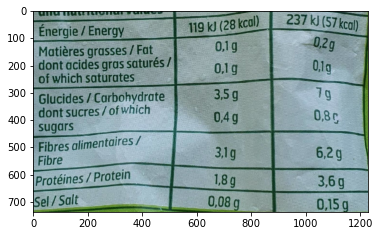

,0,1,2,3
0,Énergie /,Energy,119 kJ (28 kcal),237 kJ (57 kcal)
1,,,,
2,Matières,grasses /Fat,0.1 g,"0,2g"
3,dont acides of which,gras saturés / saturates,"0,1 g","0,1g"
4,Glucides /,Carbohydrate,"3,5 g",1g
5,dont sucres,/of which,"0,4 g","0,8C"
6,sugars Fibres Fibre,alimentaires/,"3,1g","6,2g"
7,Protéines/Protein,,"1,8 g","3,6 g"
8,Sel / Salt,,"0,08 g","0,15 g"


An error has occured


91it [00:00, 21229.30it/s]


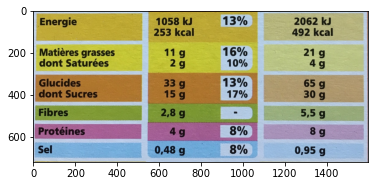

,0,1,2,3
0,Energie,,1058 kJ 13% 253 kcal,2062 kJ 492 kcal
1,Matières dont Saturées,grasses,11 g 16% 10% 2 g,21 g 4 g
2,,,33 g 13%,65 g
3,Glucides dont Sucres,,17% 15 g,30 g
4,Fibres,,"2,8 g","5,5 g"
5,,,,
6,Protéines,,4 g 8%,8 g
7,Sel,,"0,48 g 8%","0,95 g"


An error has occured


88it [00:00, 28804.34it/s]


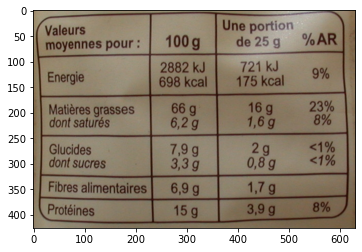

,0,1,2
0,Valeurs moyennes pour:,100 g,Une portion %AR de 25 g
1,Energie,2882 kJ 698 kcal,9% 721 kJ 175 kcal
2,Matières grasses dont saturés,"66 g 6,2 g","23% 16 g 1,6 g 8%"
3,Glucides dont sucres,"7,9 g 3,3 g","2 g <1% <1% 0,8 g"
4,Fibres alimentaires,"6,9 g","1,7 g"
5,Protéines,15 g,"3,9 g 8%"


37it [00:00, 12367.65it/s]


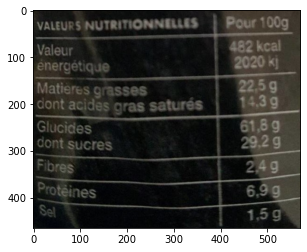

,0,1,2
0,VALEURS NUTRITIONNELLES,,Pour 100g
1,Valeur energétique,,482 kcal 2020 kj
2,Matieres grasses dont acides gras,saturés,"22,5 g 14.3 g"
3,Glucides dont sucres,,"61,8 g 29.2 g"
4,Fibres,,"2,4 g"
5,Proteines,,"6,9 g"
6,Sel,,"1,5 g"


An error has occured
An error has occured


44it [00:00, 15442.17it/s]


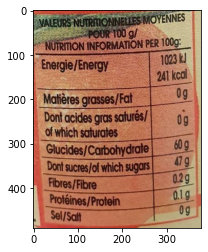

,0,1
0,VALEURS,NUTRITIONNELLES MOYENNES
1,NUTRITION,POUR 100 g/ INFORMATION PER 100g:
2,Energie/Energy,1023 kJ 241 kcal
3,Matières,0g grasses/Fat
4,Dont acides of which,gras saturés/ saturates 0g
5,,Glucides/Carbohydrate 60 g
6,,
7,Dont sucres/of,which sugars 47g
8,Fibres/Fibre,0.2g
9,,0.1 g


76it [00:00, 17312.07it/s]


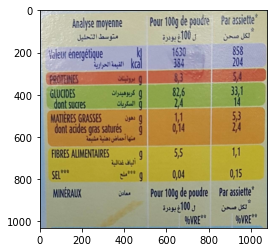

,0,1,2,3
0,Analyse moyenne متوسط التحليل,Pour 100g بودرة,de poudre فى 100غ,Par assiette لكل صحن
1,ki Haleur energétique القيمة الحرارية Kca,1630 384,,858 204
2,PROTEINES GLUCIDES dont sucres و برونينان و كربوهيدرات فو السكريات,"8,3 82,6 2,4",,"S.4 33,1 14"
3,MATIERES GRASSES dont acides gras saturés منها أحماض دهنية مشبعة,"1,1 0,14",,"2,4"
4,FIBRES ALIMENTAIRES SEL,"5,5 0,04",,"1,1 0,15"
5,MINERAUX ule,Pour 100g,de poudre,Par assiette
6,,بودرة,اں 100غ 96VRE,لكل صحن 9%VRE


30it [00:00, 14819.12it/s]


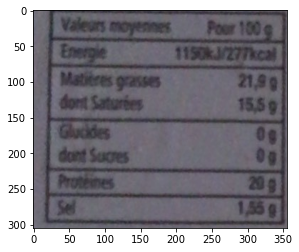

,0,1
0,Valeurs,moyennes Pour 100 g
1,Energie,1150KJ/277kcal
2,EMatieres,"grasses 21,9 9"
3,dont,"Saturées 15,5 g"
4,Gucdes,0g
5,dont,0g Sucres
6,Proteines,209
7,Sel,"1,55g"


31it [00:00, 15182.56it/s]


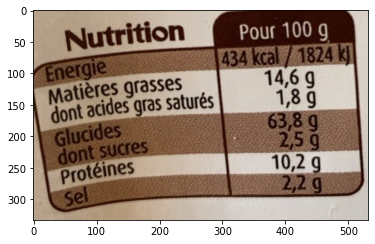

,0,1
0,Nutrition,Pour 100 g
1,Energie,434 kcal/1824 k]
2,Matières grasses,"14,6 g"
3,dont acides gras saturés,"1,8 9"
4,Glucides,"63,8 g"
5,dont sucres,"2,5 g"
6,Protéines,"10,2 g"
7,Sel,"2,2 g"
8,,


An error has occured
An error has occured


64it [00:00, 23111.10it/s]


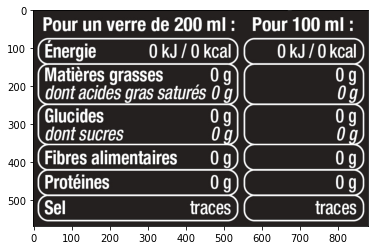

,0,1,2
0,Pour un verre de 200,ml,Pour 100 ml
1,0 kJ 0 Energie,kcal,0 kJ/O kcal
2,dont acides gras saturés Matières grasses,0g 0 g),0g O g
3,Glucides dont sucres,0 g,0 g 0 g
4,Fibres alimentaires,O g,O g
5,Protéines,0 g,0g
6,(Sel,traces,traces


107it [00:00, 17676.57it/s]


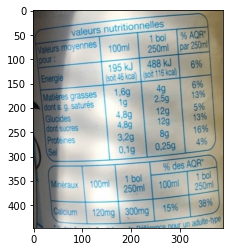

,0,1,2,3
0,valeurs,nutritionnelles,,% AQR
1,Valeurs moyennes pour:,100ml,1 bol 250ml,par 250ml
2,Energie,(soit 46 kcal) 195 kJ,488 kJ (soit 116 kcal),6%
3,Matières grasses dont ag. saturés Glucides,"1,6g 1g","4g 2,5g 12g",6% 13% 5%
4,dont sucres,"4,8g",12g,13%
5,Proteines Sel,"4,8g 3,2g 0,1g","8g 0,25g",16% 4%
6,Minéraux 100ml,1 bol 250ml,% des 100ml,AQR 1 bol 250ml
7,Calcium 120mg,300mg Référence,15% pour un,38% adulte-type


118it [00:00, 25049.49it/s]


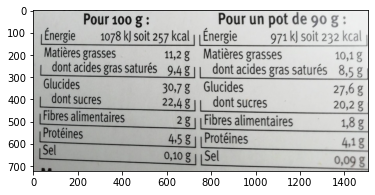

,0,1
0,Pour 100 g:,Pour un pot de 90 g:
1,Energie 1078 kJ soit 257 kcal|,971 kJ soit 232 kcal Énergie
2,"Matières grasses 11,2 g","Matières grasses 10,1 g"
3,"|dont acides gras saturés 9,4g||","dont acides gras saturés 8,5 g"
4,"Glucides 30,7 g","Glucides 27,6 g"
5,"dont sucres 22,4 g ||","dont sucres 20,2 g"
6,2g1|Fibres Fibres alimentaires,"alimentaires 1,8 g"
7,4.5 g|| Protéines,"Protéines 4,1g"
8,"0,10 g| | Sel","Sel 0,09 g"


24it [00:00, 7562.98it/s]


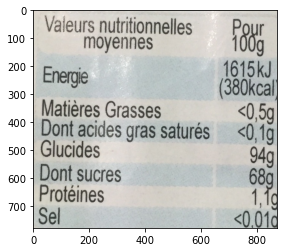

,0,1,2
0,Valeurs moyennes,nutritionnelles,Pour 100g
1,,,1615kJ
2,Energie,,(380kcal)
3,Matières,Grasses,"<0,5g"
4,Dont acides,gras saturés,"<0,1g"
5,Glucides,,949
6,Dont sucres,,68g
7,,,
8,Proteines,,"1,1g"
9,,,"<0,01"


33it [00:00, 18957.96it/s]


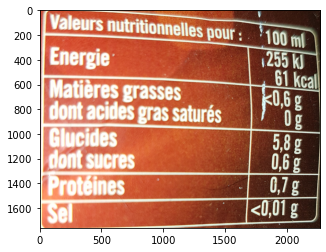

,0,1
0,Valeurs nutritionnelles,pour : 100 ml
1,Energie,255 kJ 61 kcal
2,Matières grasses,"K0,6 g"
3,dont acides gras saturés,Og
4,Glucides dont sucres,"5,8 g 0,6 g"
5,Proteines,"0,7 g"
6,Sel,"<0,01 g"


52it [00:00, 26092.09it/s]


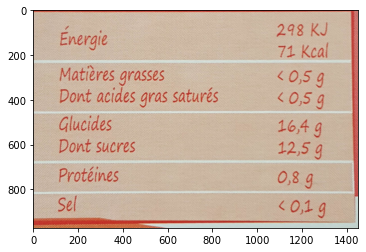

,0,1,2,3
0,,,,298 KJ
1,,Energie,,71 Kcal
2,,Matières grasses,,"0,5 g"
3,Dont,acides gras,saturés,"0,5 g"
4,,Glucides,,"16,4 9"
5,Dont,sucres,,"12,5 g"
6,,Protéines,,"0,89"
7,Sel,,,"0,1 g"


102it [00:00, 19403.10it/s]


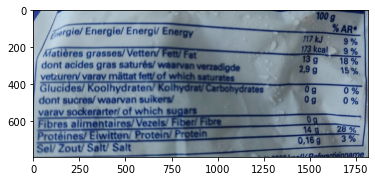

,0,1
0,,100 g % AR*
1,Energiel Energiel Energi/ Energy 117 173,kJ kcal 9 % 9 %
2,13 Matières grasses/Vetten/ Fett/ Fat acides saturés/ waarvan verzadigde,g 18 %
3,"2,9 dont gras vetzuren/ varav mättat fett/ of which saturates","g 15%,"
4,Glucides/ Koolhydraten/ Kolhydrat/ Carbohydrates,0%
5,dont sucres/waarvan suikers/ varav sockerarter/ of which sugars 0,0 % g
6,Fibres alimentaires/Vezels/ Fiber/ Fibre 0g 14,g 28 %
7,"Proteines/Eiwitten/ Protein/ Protein Sel/ Zout/ Salt/ Salt 0,16",g 3%


An error has occured


31it [00:00, 30629.78it/s]


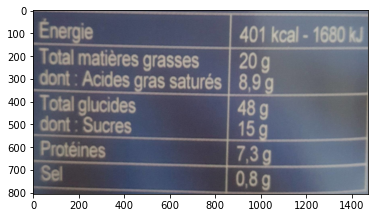

,0,1,2
0,Énergie,,401 kcal - 1680 kJ
1,Total matières,grasses,20g
2,dont : Acides,gras saturés,"8,9 g"
3,Total glucides dont: Sucres,,48g 15g
4,Protéines,,"7,3g"
5,Sel,,"0,8g"


37it [00:00, 18558.87it/s]


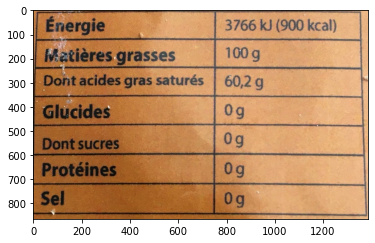

,0,1,2
0,Énergie,3766 kJ (900,kcal)
1,Matières,100g grasses,
2,Dont acides gras,"saturés 60,2 g",
3,Glucides,0g,
4,Dont sucres,0g,
5,Protéines,0g,
6,Sel,0g,


58it [00:00, 13809.58it/s]


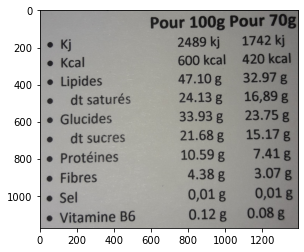

,0,1,2,3
0,,Pour,100g 2489 kj,Pour 70g 1742 kj
1,Kj,,,
2,Kcal,,600 kcal,420 kcal
3,Lipides,,47.10 g,32.97 g
4,,,,
5,,,,
6,dt,saturés,24.13 g,"16,89 g"
7,,,,23.75
8,,Glucides,33.93 g,g
9,dt,sucres,21.68 g,15.17 g


36it [00:00, 18055.12it/s]


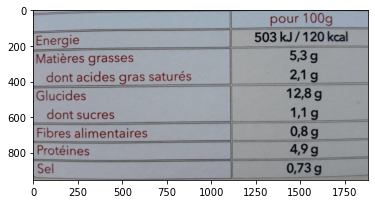

,0,1,2
0,,,pour 100g
1,Energie,503,kJ/120 kcal
2,Matières grasses,,"5,3 g"
3,dont acides gras saturés,,"2,1 g"
4,Glucides dont sucres,,"12,8 g 1,1 g"
5,Fibres alimentaires,,"0,8 g"
6,Protéines,,"4,9 g"
7,Sel,,"0,73 g"


61it [00:00, 23918.16it/s]


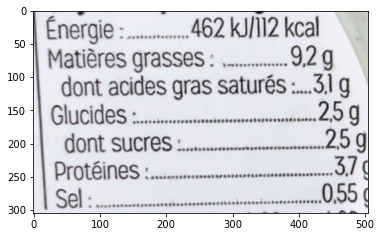

,0,1,2
0,Énergie,:.. .462,kJ/112 kcal
1,Matières,grasses: .,"9,2 g .........."
2,dont,acides gras saturés,.31 g
3,Glucides,.,.25g
4,dont,sucres:,25g
5,Protéines:.,,"3,7"
6,| Sel :..,,"„0,55"


An error has occured


114it [00:00, 57195.05it/s]


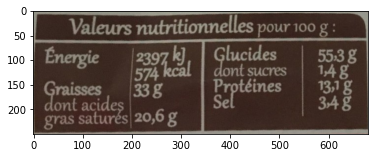

,0,1,2
0,,,
1,Valeurs nutritionnelles,pour 100,g:
2,"Energie 2397 kJ, kcal",Glucides dont,55.3g
3,574,sucres,"1,4g"
4,33 g Graisses,Protéines,"13,1 g"
5,"dont acides gras satures 20,6 g",Sel,34g


24it [00:00, 21532.26it/s]


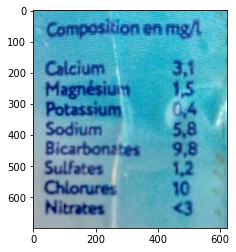

,0,1,2,3
0,Composition,,en,mg/
1,,,,
2,Calcium,,,"3,1"
3,Magnésium,,,"1,5"
4,Potassium,,,"0,4"
5,Sodium,,,"5,8"
6,Bicarbonates,,,"9,8"
7,Sulfates,,,"1,2"
8,Chlorures,,,10
9,,,,


An error has occured


36it [00:00, 11207.23it/s]


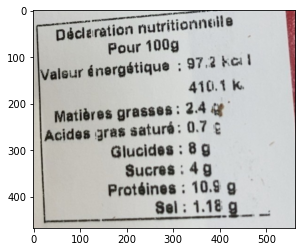

,0,1
0,Décleration,nutritionneile
1,Pour 100g,
2,Valsur énergétique :,97.2 kc l
3,,410.1 k.
4,Matières grasses: Acides gras saturé:,2.4 0.7 g
5,Glucides :,8 g
6,Sucres :,4 g
7,Protéines :,10.9 g
8,Sel:,1.18 g


33it [00:00, 7718.29it/s]


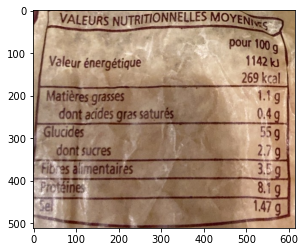

,0,1,2
0,VALEURS,,NUTRITIONNELLES
1,,,pour 100 g
2,,,1142 kJ
3,Valeur,énergétique,269 kcal
4,Matières dont,grasses acides,1.1g 0.4g gras saturés
5,Glucides dont,sucres,55 g 2.7g
6,Fibres,alimentaires,3.5g
7,,,
8,Protéines,,8.19
9,Sel,,1.47 g


26it [00:00, 12003.51it/s]


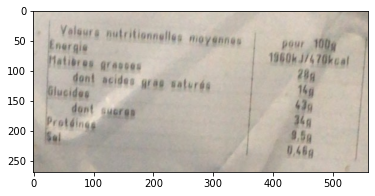

,0,1,2,3
0,Valsurs,nutritionnelles moyennes,pour,100g
1,Energie,,1960k,J/470kcal
2,,,,28g
3,Matibres,grases,,
4,,,,
5,dont,acides gras saturés,,14g
6,,,,
7,Glucides,,,439
8,dont,sueres,,349
9,Protdings Sel,,,"9,5g 0.46g"


An error has occured


28it [00:00, 13235.72it/s]


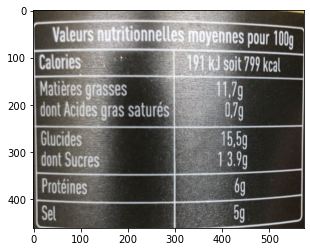

,0,1,2
0,Valeurs,nutritionnelles,moyennes pour 100g
1,Calories,,191 kJ soit 799 kcal
2,Matières grasses dont Acides,gras saturés,11.7g 0.79
3,Glucides,,"15,5g"
4,dont Sucres,,13.9g
5,Protéines,,6g
6,Sel,,5g


An error has occured


26it [00:00, 17178.94it/s]


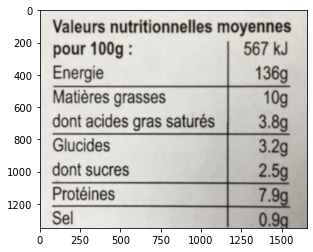

,0,1,2
0,Valeurs,nutritionnelles,moyennes
1,pour 100g,,567 kJ
2,Energie,,136g
3,Matières,grasses,10g
4,dont acides,gras saturés,3.8g
5,Glucides,,3.2g
6,dont sucres,,2.5g
7,Protéines,,7.9g
8,Sel,,0.9g


102it [00:00, 18884.92it/s]


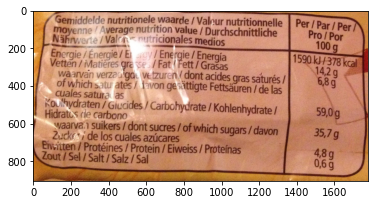

,0,1
0,Gemiddelde nutritionele waarde /Valeur nutrition value /,Per /Par/ Per nutritionnelle Durchschnittliche Pro Por
1,moyenne/Average Nährwerte/Valer utricionales medios,100 g
2,Energie/Énergie/ Ey/Energie / Energía Vetten/Matières gra se /FatFett/ Grasas verzadga vetzuren dont acides,"1590 kJ/378 kcal 14,2 9 6,8g gras saturés/"
3,waarvan ates/ lavon gesattigte Fettsäuren,/de las
4,of which satu,
5,cuales satura as Koulhydraten/Giucides/Carbohydrate /,"Kohlenhydrate/ 59,0g"
6,Hidratos de carbono waarvan suikers/ dont sucres / of which,"35,7 g sugars/davon"
7,azúcares,
8,Zuck de los cuales Eivitten/ Protéines / Protein/Eiweiss / Proteínas Zout/Sel/Salt / Salz/Sal,"4,8g 0,6g"


An error has occured


69it [00:00, 22885.26it/s]


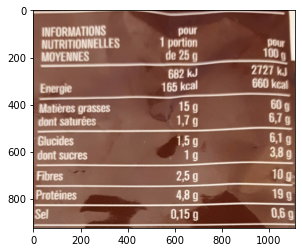

,0,1,2
0,INFORMATIONS NUTRITIONNELLES ΜΟΥΕΝNES 1,pour portion de 25 g,pour 100 g
1,Energie,682 kJ 165 kcal,2727 kJ 660 kcal
2,Matières grasses dont saturées,"15 g 1,7 g","60 g 6,7 g 6,1"
3,Glucides dont sucres,"1,5 g 1 g","g 3,8 g"
4,,"2,5 g",10 g
5,Fibres,"4,8 g",19 g
6,Protéines Sel,"0,15 g","0,6 g"


40it [00:00, 24866.19it/s]


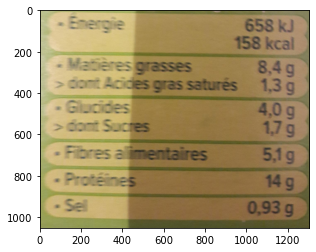

,0,1,2
0,Energie,658,kJ
1,,158,kcal
2,dont Acides Matières,gras saturés grasses,"8,4 g 1,3 g"
3,-Glucides,,"4,0 g"
4,>dont Sucres,,"1,7 g"
5,-Fibres,alimentaires,"5,1g"
6,Protéines,,14 g
7,-Sell,,"0,93 g"


31it [00:00, 14691.91it/s]


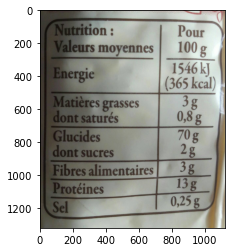

,0,1,2
0,Nutrition: Valeurs,moyennes,Pour 100 g
1,Energie,,1546 kJ (365 kcal)
2,Matières dont,grasses saturés,"3g 0,8g"
3,Glucides dont,sucres,70 g 2g
4,,,
5,Fibres Protéines,alimentaires,"3g 13g 0,25 g"
6,Sel,,


149it [00:00, 18093.55it/s]


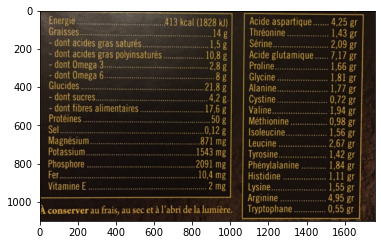

,0,1,2,3
0,Energie Graisses. - dont acides gras -dont acides gras 3..,"413 kcal (1828 kJ) 14g .1,5 g 10,8g .2,8 g saturés polyinsaturés",Acide aspartique. Thréonine. .. Sérine.. . Acide glutamique. Proline...,"4,25 gr 1,43 gr 2,09 gr 7,17 gr 1,66 gr"
1,dont Omega -dont Omega 6... Glucides,".8g .21,8 g 4,2 g.",Glycine Alanine... Cystine.,"1,81 gr 1,77 gr 0,72 gr"
2,- dont sucres... - dont fibres alimentaires Protéines Sel. Magnésium. Potassium.,"17,6g .50g .0,12 g 871 mg 1543 mg",Valine.. Méthionine Isoleucine. Leucine Tyrosine..,"1,94 gr 0,98 gr 1,56 gr 2,67 gr 1,42 gr 1,84 gr"
3,Phosphore Fer. Vitamine E,".2091 mg .10,4 mg 2 mg",Phénylalanine Histidine Lysine.. Arginine,"1,11 gr 1,55 gr 4,95 gr"
4,"A conserver au frais,",au sec et à l’abri de la lumière.,Tryptophane.,"0,55 gr"


45it [00:00, 22560.80it/s]


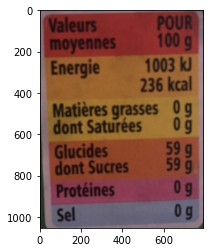

,0,1
0,Valeurs,POUR
1,moyennes 100,g
2,Energie 1003,kJ
3,236,kcal
4,Matières grasses,0g
5,,
6,dont Saturées,0 g
7,Glucides,59 g
8,dont Sucres,59 g
9,Protéines,09


41it [00:00, 20084.85it/s]


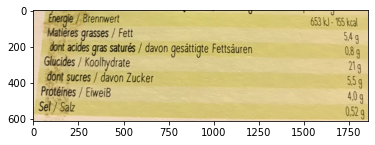

,0,1
0,Energie/ Brennwert,653 kJ- 155 kcal
1,grasses/Fett,549
2,Matieres,
3,acides gras,"saturés / davon gesattiqte Fettsåuren 0,89"
4,dont,
5,Glucides/Koolhydrate,219
6,dont sucres /,davon Zucker 55g
7,Protéines/EiweiB,"4,0g"
8,Sel/Salz,"0,52g"


An error has occured


C:\Users\ytremenbert\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:3372: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
58it [00:00, ?it/s]


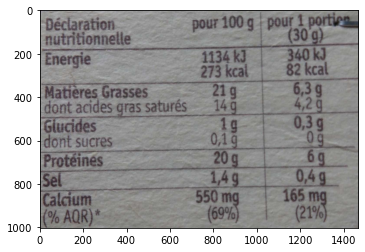

,0
0,


An error has occured
An error has occured
An error has occured


42it [00:00, 13683.45it/s]


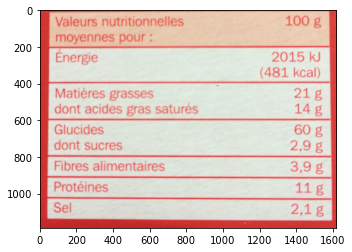

,0,1
0,| Valeurs nutritionnelles moyennes pour :,100 g
1,Énergie,2015 kJ (481 kcal)
2,Matières grasses dont acides gras saturés,21 g 14 g
3,Glucides dont sucres,"60 g 2,9 g"
4,Fibres alimentaires,"3,9 g"
5,Protéines,11 g
6,,
7,Sel,"2,1 g"


An error has occured
An error has occured


C:\Users\ytremenbert\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:3372: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
115it [00:00, 109375.27it/s]


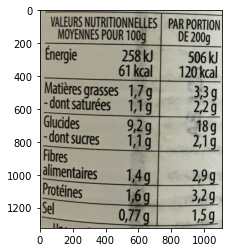

,0,1,2
0,,,
1,,,


131it [00:00, 42113.42it/s]


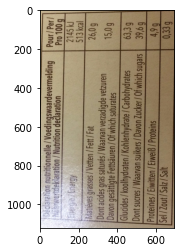

,0,1
0,"Pour/ Per/ Dedaration Pro 100 g 2145 kJ 513 kcal 26,0 g Energie Matières Dont acides Davon Dont Sel 15,0g 63,3 g 39,6 g 4,9g 0,33 g",
1,nutritionnelle /Voedingswaardevermelding Nahnwertdeklaration/Nutrition declaration,
2,/Energy,
3,grasses/Vetten /Fett/Fat gras saturés/Waarvan verzadigde gesättigte Fettsãuren/Of which saturates,vetzuren
4,Glucides/koolhydraten/ Kohlenhydrate sucres/Waarvan suikers / Davon Zucker/Of,/Carbohydrates which suqars
5,Proteines/Eiwitten/Eiweiß/Proteins,
6,/Zout/Salz/Salt,


An error has occured


C:\Users\ytremenbert\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:3372: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
81it [00:00, 81121.93it/s]


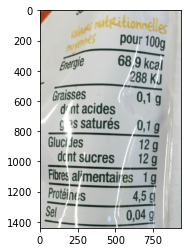

,0
0,


An error has occured


33it [00:00, 12378.11it/s]


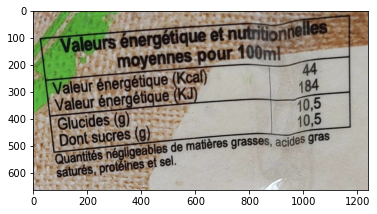

,0,1
0,,
1,Valeurs,énergétique et nutritionnelles
2,,moyennes pour 100ml
3,Valeur énergétique Valeur,(Kcal) 44
4,énergétique,(KJ) 184
5,Glucides (g),"10,5"
6,Dont sucres (g),"10,5"
7,Quantités négligeables et,"de matières grasses, acides gras sel."
8,"saturés, protéines",


218it [00:00, 16954.54it/s]


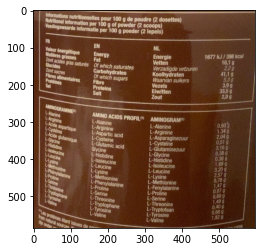

,0,1,2,3,4
0,"Informations nutritionnelles Nutritional information per Voedingswaarde informatie sources, de tip onder",pour 100 g 100 g of powder per 100 g,de poudre (2 dosettes) (2 scoops) poeder (2 lepels),,
1,FR Valeur énergétique Matières grasses Dont acides gras saturés Glucides,EN Of which saturates Energy Fat,NL Energie Vetten Verzadigde vetzuren Koolhydraten,"1677 kJ/ 398 10,1 2,2g 41,1g 5,3g",kcal g
2,Dont sucres Fibres alimentaires Proteines Sel,Carbohydrates Of which sugars Fibre Proteins Salt,Waarvan suikers Vezels Eiwitten Zout,"3,9 33,5g 2,0",g g
3,AMINOGRAMME L-Alanine L-Arginine L-Acide aspartique L-Oystéine L-Acide glutamique L-Glycine L-Histidine L-soleucine,AMINO ACIDS L-Alanine L-Arginine L-Aspartic acid L-Cysteine L-Glutamic Glycine L-Histidine,PROFIL AMINOGRAM acid L-Alanine L-Arginine L-Asparaginezuur L-Cysteine L-Giutaminezuur L-Glycine L-Histidine,"0,93 1,34 2,04 0,51 3,16 0,38 0,38 1,69",g g g g g g g
4,L-Leucine L-Lysine L-Methionine L-Phénylalanine,L-Isoleucine L-Leucine L-Lysine L-Methionine,L-Isoleucine L-Leucine L-Lysine L-Methionine,"3,20 2,57 0,78 1,47",g g g g
5,L-Proline L-Sérine L-Thréonine L-Tryptophane L-yrosine L-Valine tom natural Les proteines étant issues,L-Phenylalanine L-Proline L-Serine L-Threonine L-Tryptophane L-Tyrosine L-Valine,L-Fenylalanine L-Proline L-Serine L-Threonine L-Tryptofaan L-Tyrosine L-Valine,"0.87 0,89 1,49 0,40 0,68 1,82",g g g g g g come


31it [00:00, 15648.50it/s]


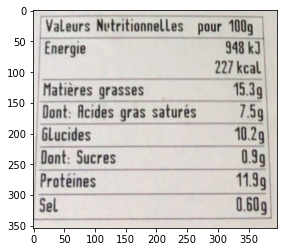

,0,1
0,Valeurs Nutritionnelles pour,100g
1,Energie,948 kJ
2,,227 kcal
3,Matières grasses,15.3g
4,Dont: Acides gras saturés,7.5g
5,Glucides,10.2g
6,Dont: Sucres,0.9g
7,Protéines,11.9g
8,Sel,0.60g


115it [00:00, 18295.59it/s]


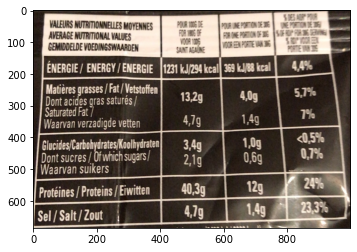

,0,1,2,3,4
0,VALEURS NUTRITIONNELLES AVERAGE NUTRITIONAL,MOYENNES VALUES,POUR 1006 DE FOR 1006 OF,POUR UNE PORTION DE 3ENE FOR ONE PORTION OF 306,SDES ABP POUR PORTION DE 5FP FIR EVING
1,GEMIDDELDE,VOEDINGSWAARDEN,VOOR 1006 SAINT AGAÜNE,VOOR EEN PORTIE VAN 3,SOP OOR GEN PORTE VN E
2,ÉNERGIE / ENERGY,/ ENERGIE,1231 kJ/294 kcal,369 kJ/88 kcal,"4,4%"
3,Matières grasses / Dont acides gras,Fat /Vetstoffen saturés /,"13,2g","4,0g","5,7%"
4,Saturated Fat7 Waarvan verzadigde,vetten,"4,7g","1,4g",7%
5,Glucides/Carbohydrates/Koolhydraten Dont sucres/Of Waarvan suikers,which sugars/,"3,4g 2,1g","1,0g 0,6g","<0,5% 0,7%"
6,Protéines/Proteins,/Eiwitten,"40,3g",12g,24%
7,Sel/Salt/Zout,,"4,7g","1,4g","23,3%"


34it [00:00, 17043.90it/s]


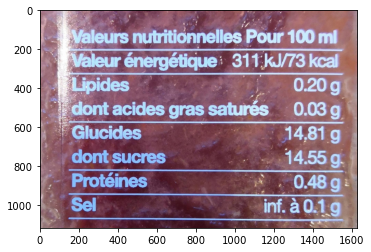

,0,1
0,,
1,Valeurs nutritionnelles Pour,100 ml
2,Valeur énergétique 311,kJ/73 kcal
3,Lipides,0.20 g
4,dont acides gras saturés R,0.03 g
5,Glucides,"14,81 g"
6,,
7,dont sucres,14.55 g.
8,Protéines,0.48 g
9,inf. Sel,à 0.1g


101it [00:00, 35056.66it/s]


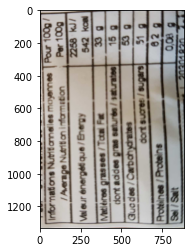

,0,1
0,100g/ 100g Val eur kJ/ kcal 33 g g 53 g 9 51 82,Pour
1,Informations Nutriiannelles IAverage Nutrit on information,mayennes Per
2,energéti que / Energy,2258 542
3,Matieres grasses /Tatni Fat saturés/saturates,15
4,dont addes gras Qucdes/Carbahydrates dont,sucres/sugars
5,Proteines/Proteins Sel/Salt,"0,08"
6,,L 20301830


C:\Users\ytremenbert\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:3372: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
98it [00:00, ?it/s]


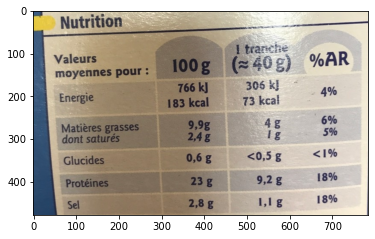

,0,1
0,,
1,,


C:\Users\ytremenbert\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:3372: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
76it [00:00, ?it/s]


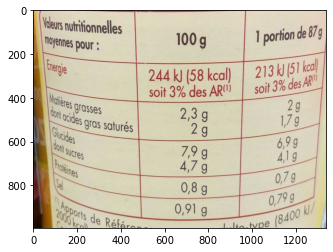

,0,1
0,,
1,,


24it [00:00, 23967.45it/s]


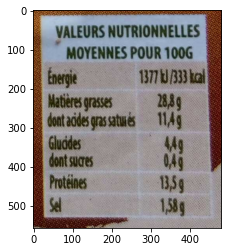

,0,1,2
0,,VALEURSNUTRIONNELLES,
1,,MOYENNES POUR,100G
2,Energie,,
3,Matieres,grasses,
4,,,
5,,,
6,Guddes dontsuaes,,
7,Protéines,,
8,,,


36it [00:00, 11632.89it/s]


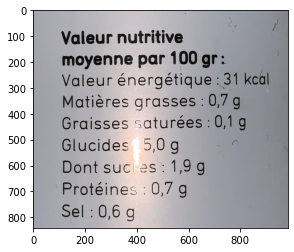

,0,1,2
0,,,
1,,Valeur,nutritive
2,,,
3,,moyenne,par 100 gr:
4,,Valeur,énergétique : 31 kcal
5,,Matières,"grasses : 0,7 g"
6,,Graisses,"saturées : 0,1 g"
7,,Glucides,"5,0 g"
8,Dont,suckes,"1,9 g"
9,,Protéines,": 0,7 g"


24it [00:00, 24059.11it/s]


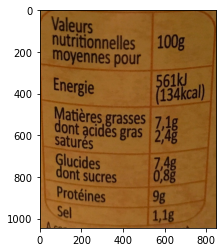

,0,1
0,Valeurs,
1,nutritionnelles moyennes pour,100g
2,Energie,561k 134kcal)
3,Matières grasses dont acides gras saturés,"7,1g"
4,Glucides dont sucres,"7,4g 0,8g"
5,Protéines,9g
6,Sel,"1,1g"


An error has occured


35it [00:00, 15376.63it/s]


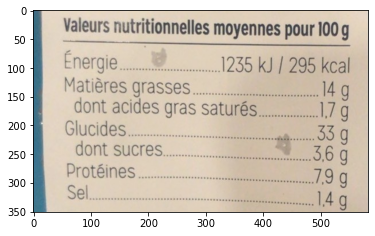

,0,1,2
0,Valeurs nutritionnelles,moyennes,pour 100 g
1,Énergie.,1235,kJ / 295 kcal
2,Matières grasses,.,14 g
3,dont acides gras,saturés.,1.7 g
4,Glucides.,,.33 g
5,dont sucres..,,".3,6g"
6,Protéines..,,79 g
7,Sel.,,1.4 g


110it [00:00, 32155.94it/s]


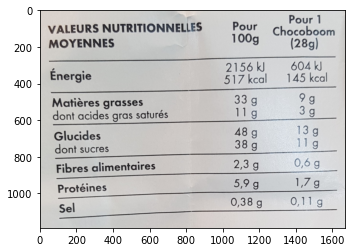

,0,1
0,VALEURS MOYENNES,Pour 1 (28g) Pour chocoboom NUTRITIONNELLES 100g
1,Énergie,604 kJ 2156 kJ 517 kcal 145 kcal
2,Matières grasses dont acides gras,33 g 11 g 9 g saturés 3 g
3,Glucides dont sucres,48 g 38 g 13 g 11 g
4,,"0,6 g"
5,Fibres alimentaires,"2,3 g"
6,,"5,9 g 1,7 g"
7,Protéines,
8,,"0,38 g 0,11 g"
9,Sel,


36it [00:00, 12159.36it/s]


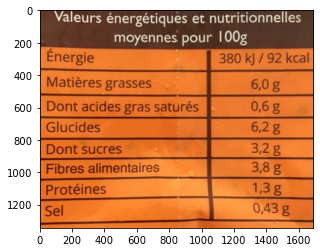

,0,1
0,Valeurs énergétiques et moyennes pour,nutritionnelles 100g
1,Énergie,380 kJ/92 kcal
2,Matières grasses,"6,0 g"
3,Dont acides gras saturés,"0,6g"
4,,
5,Glucides,"6,2 g"
6,Dont sucres,"3,2 g"
7,,
8,Fibres alimentaires,"3,8 g"
9,,


34it [00:00, 14800.87it/s]


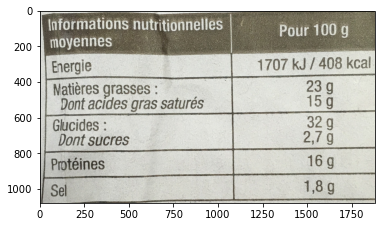

,0,1,2,3
0,Informations moyennes,nutritionnelles,Pour,100 g
1,Energie,,1707 kJ,408 kcal
2,Natières grasses: Dont acides gras,saturés,,23 g 15 g
3,Glucides Dont sucres,,,"32 g 2,7 g"
4,Protéines,,,16 g
5,Sel,,,"1,8 g"


37it [00:00, 37099.99it/s]


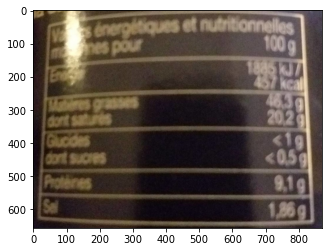

,0,1
0,énergétiques et nutritionnelles,
1,m es pour,100 g
2,,1885 KJ7 457kcal
3,Materes grasses dont satures,46.3g 202
4,Glucdes dont sucres,<19 <0.5g
5,Proteines,"9,1g"
6,Sal,"1.,86g"


55it [00:00, 17043.72it/s]


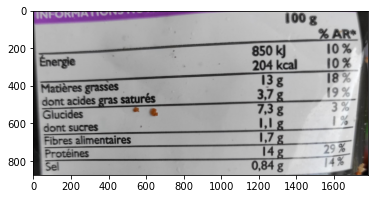

,0,1
0,INFORMATIONS,100 g % AR
1,Énergie,850 kJ 204 kcal 10% 10%
2,Matières grasses dont acides gras saturés,"13g 3,7g 18% 19% 3%"
3,Glucides dont sucres,"7,3 g 1,1g"
4,,
5,Fibres alimentaires,"1,7 g"
6,,14g 29 %
7,Protéines,
8,Sel,"0,84g 14%"


An error has occured


73it [00:00, 26221.13it/s]


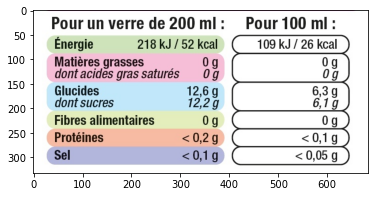

,0,1
0,Pour un verre de 200 ml,Pour 100 ml
1,Énergie 218 kJ / 52 kcal,109 kJ 26 kcal
2,0 g 0 g Matières grasses dont acides gras saturés,0 g 0 g
3,"12,6 g 12,2g Glucides dont sucres","6,3 g 6,1 g"
4,0 g Fibres alimentaires,o g
5,"<0,2 g Protéines","<0,1 g"
6,"<0,1 g Sel","<0,05 g"


55it [00:00, 17969.05it/s]


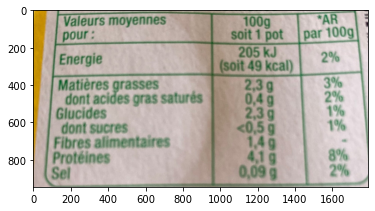

,0,1,2,3
0,Valeurs moyennes,,100g,*AR
1,pour:,,soit 1 pot,par 100g
2,Energie,,205 kJ (soit 49 kcal),2%
3,Matières grasses,,"2,3g",3%
4,dont acides gras,saturés,"0,4g",2%
5,Glucides,,"2,3g",1%
6,dont sucres,,"<0,5 g",1%
7,Fibres alimentaires Protéines Sel,,"1,4g 4,1g 0,09 g",8% 2%


75it [00:00, 21956.64it/s]


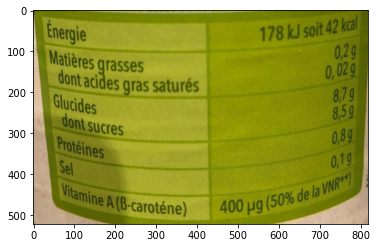

,0,1,2,3
0,,,178 kJ soit,42 kcal
1,Energie,,,"0,2g"
2,Matières dont acides,grasses gras saturés,,"0,02 g 8,7g"
3,Glucides dont sucres,,,"8,5g 0,89 006"
4,Protéines,,,"0,19"
5,Sel,,de la,VNR**)
6,Vitamine A,(B-caroténe),400 µg (50%,


58it [00:00, 21207.36it/s]


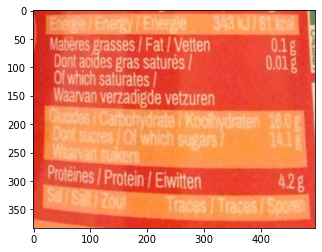

,0,1
0,Energie/Energy/Energje,343 kJ/81 kcal
1,Matières grasses/Fat /,Vetten
2,Dont acides gras saturés/,0.01g
3,Of which saturates/,
4,,
5,Waarvan verzadigde,vetzuren
6,Gluaides/Carbohydrate,/Koolhydraten 18.0 g
7,Dont sucres/Of which,sugars 141
8,Waarvan suikers,
9,Protéines/ Protein/Eiwitten,428


An error has occured


63it [00:00, 63155.15it/s]


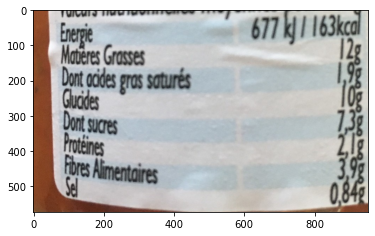

,0,1
0,Valeurs,677k1163kcal
1,Energie,12g
2,Matieres Grasses odes gros,saturés
3,Dont,
4,Gluades,
5,Dont sucres,
6,Proteines,
7,Fibres Alimentaires,
8,Sel,


60it [00:00, 16608.91it/s]


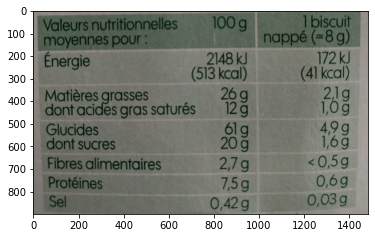

,0,1,2,3,4
0,Valeurs moyennes,nutritionnelles pour:,100 g,1 nappé,biscuit (=8 g)
1,Énergie,(513,2148 kJ kcal),(41,172 kJ kcal)
2,Matières grasses dont acides,gras saturés,26g 12g,,"2,1g 1,0g"
3,Glucides dont sucres,,61g 20 g,,"4,9 g 1,6g"
4,Fibres alimentaires,,"2,7g",,"< 0,5g"
5,Protéines,,"7,5g",,"0,6g"
6,Sel,,"0,42 g",,"0,03 g"


C:\Users\ytremenbert\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:3372: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
45it [00:00, ?it/s]


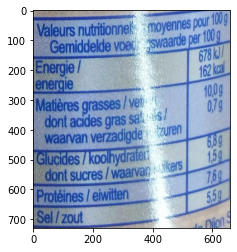

,0
0,


29it [00:00, 25791.95it/s]


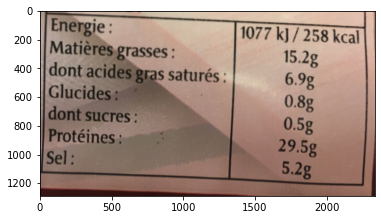

,0,1,2
0,Energie:,,1077 kJ/258 kcal
1,,,15.2g
2,Matières,grasses:,
3,|dont,acides gras saturés:,6.9g
4,,Glucides:,0.8g
5,dont,sucres:,0.5g
6,,Protéines:,29.5g
7,Sel:,,5.2g
8,,,


An error has occured


35it [00:00, 17589.34it/s]


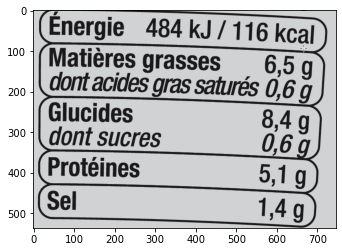

,0,1
0,(Énergie,484 kJ 116 kcal
1,Matières,"6,5 g grasses"
2,dont acides,"gras saturés 0,6 g"
3,Glucides,"8,4 g"
4,dont sucres,"0,6 g"
5,Protéines,"5,1 g"
6,Sel,"1,4 g"


137it [00:00, 63797.01it/s]


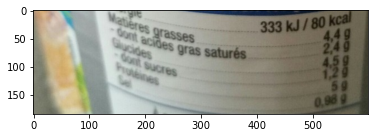

,0,1
0,,"333 kJ/80 kcal 4,4 g"
1,,"Matieres grasses Gont acides gras saturés 2,49"
2,,
3,,
4,,Glucides Gont 59
5,,sucres
6,,
7,,Proteines Se 0.98 9
8,,
9,,A


C:\Users\ytremenbert\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:3372: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
53it [00:00, ?it/s]


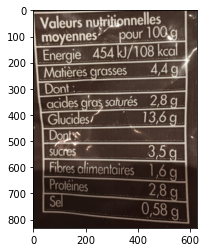

,0
0,


44it [00:00, 15777.50it/s]


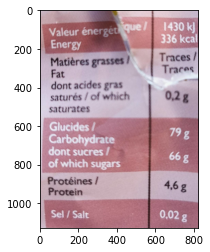

,0,1
0,Valeur énergétque / Energy,1430 k 336 kcal
1,Matières grasses! Fat,Traces/ Traces
2,,
3,dont acides gras saturés / of which saturates,"0,2g"
4,Glucides / Carbohydrate,79g
5,dont sucres / of which sugars,66 8
6,Protéines / Protein,"4,6 g"
7,Sel / Salt,"0,02 g"


60it [00:00, 32952.50it/s]


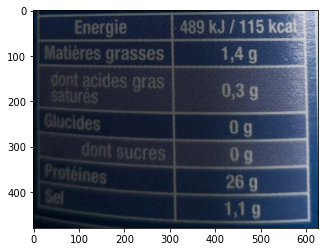

,0,1,2
0,Energie,489,kJ/115 kcal
1,Matières grasses,,"1,4 g"
2,dont acides gras saturés,,"0,3 g"
3,Glucides,,0g
4,dont sucres,,0g
5,Protéines,,26 g
6,Sel,,"1,1 g"


64it [00:00, 13187.69it/s]


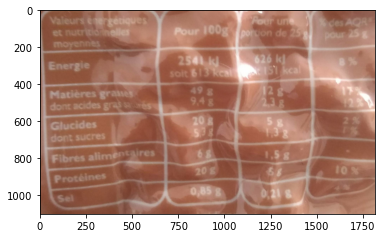

,0,1,2,3,4
0,Valeurs et nutritioninelles moyennes,energetiques,Pour 100g,Four une portion de 25,des AQR pour 25 g
1,Energie,,soit 613 kcal 2541 k,626 kl IST kcal,8%
2,Matières dont acides,grases gas saes,"49 8 9,48","12g 2,3g 0800",17% 12
3,Glucides dont sucres,,20g 538,5 8 1.38,2%
4,,,68,"1,5g",
5,Fibres Protéines,alimentaires,20g,68,10%
6,Sel,,"0,85 g","0,21 8",


74it [00:00, 37413.03it/s]


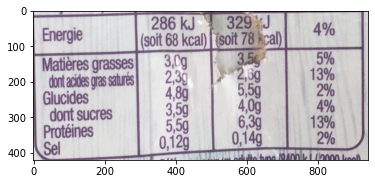

,0,1,2,3
0,,286 kJ,329 J,4%
1,Energie,(soit 68 kcal)(soit,78 kcal),
2,Matières grasses,"3,0g","3.5g 2,6g",5% 13%
3,dont acides gras satures,"2,3g 4,89 435","5,50",2%
4,Glucides,"3,5g","4,0g",4%
5,dont sucres,,"6,30",13%
6,Protéines Sel,"5,5g 0,12g","0,14g",2% kal.


An error has occured
An error has occured


51it [00:00, 17048.66it/s]


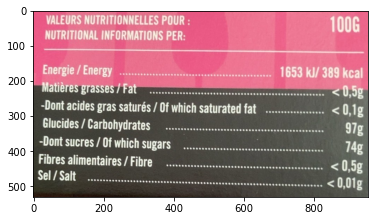

,0,1
0,VALEURS NUTRITIONAL,100G NUTRITIONNELLES POUR: INFORMATIONS PER:
1,Energie / Energy,1653 kJ/ 389 kcal
2,Matières grasses/Fat -Dont acides gras,"saturés / Of which saturated fat < 0,5g < 0,1g"
3,Glucides / -Dont sucres / Of,Carbohydrates 97g 74g which sugars
4,Fibres alimentaires,"< 0,5g / Fibre"
5,Sel / Salt,"< 0,01g"


An error has occured


58it [00:00, 29246.17it/s]


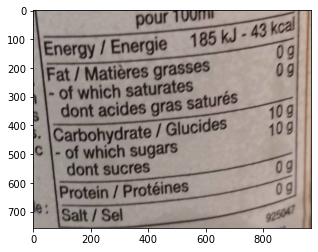

,0,1
0,pour,100ml
1,Energy/Energie,185 kJ -43 kcal
2,Fat/Matières grasses bien-of which saturates,0g 0g
3,dont acides gras,saturés
4,Carbohydrate/Glucides,10 g 10 g
5,of which sugars dont sucres,
6,Protein/Protéines,0g 0g
7,Salt/Sel le:,925047


29it [00:00, 25314.22it/s]


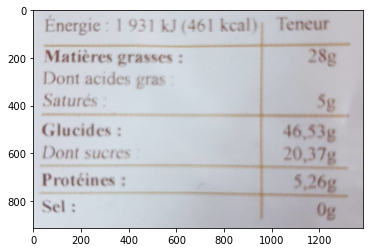

,0,1,2
0,Energie : 1 931,kJ (461 kcal),Teneur
1,Matières grasses:,,28g
2,Dont acides gras Saturés:,,5g
3,Glucides:,,"46,53g"
4,Dont sucres,,"20,37g"
5,Protéines:,,"5,26g"
6,Sel:,,0g


An error has occured


28it [00:00, 13636.85it/s]


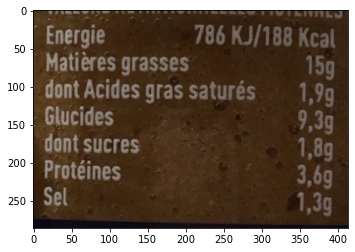

,0,1,2,3
0,Energie,786,KJ/188,Kcal
1,Matières,grasses,,15g
2,dont,Acides gras saturés,,"1,9g9"
3,Glucides,,,"9,3g"
4,dont,sucres,,"1,8g"
5,Protéines,,,"3,69"
6,Sel,,,"1,3g"


C:\Users\ytremenbert\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:3372: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
41it [00:00, ?it/s]


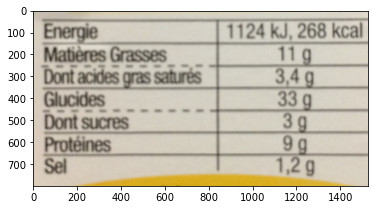

,0,1,2
0,,,
1,,,


43it [00:00, 14744.53it/s]


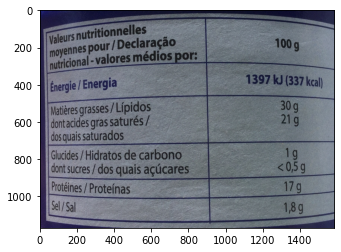

,0,1,2,3
0,Valeurs moyennes nutricional-valores,nutritionnelles pour/ Declaração médios por:,100,g
1,Energie/Energia,,1397 kJ (337,kcall
2,Matières |dont acides |dos quais,grasses/Lípidos gras saturés/ saturados,30 g 21g,
3,Glucides/Hidratos dont sucres/dos,de carbono quais açúcares,"19 <0,5g",
4,Protéines,/Proteínas,17,g
5,Sel/Sal,,"1,8",g


34it [00:00, 11365.77it/s]


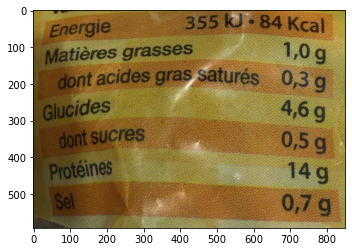

,0,1,2,3
0,Energie,355,kJ 84,Kcal
1,,,,
2,Matières,grasses,,"1,0 g"
3,dont acides,gras saturés,,"0,3 g"
4,Glucides,,,"4,6 g"
5,dont sucres,,,"0,5 g"
6,,,,
7,Protéines,,,14
8,,,,g
9,Sel,,,"0,7 g"


32it [00:00, 9314.85it/s]


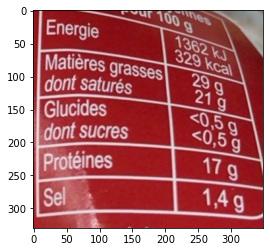

,0,1
0,pour,moyennes 100 g
1,Energie,1362 kJ 329 kcal
2,Matières grasses dont saturés,29 g 21 g
3,Glucides sucres,"<0,5g <0,5 g"
4,dont Protéines,17g
5,,"1,4 g"
6,Sel,


102it [00:00, 51395.84it/s]


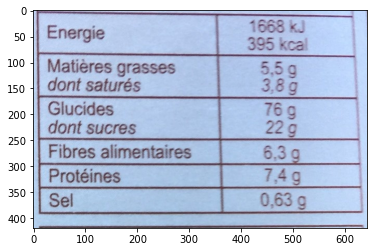

,0,1
0,Energie,1668 kJ 395 kcal
1,Matières grasses dont saturés,"5,5 g 3,8 g"
2,Glucides dont sucres,76 g 22 g
3,Fibres alimentaires,6.3g
4,Protéines,"7,4g"
5,Sel,"0,63 g"


An error has occured
An error has occured


124it [00:00, 17288.62it/s]


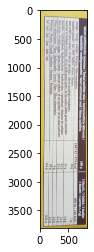

,0,1,2,3
0,3 biscuits/3 Gebãch/3 Koekjes 3 Biscotti / 3 Galettas (-35g) 100 g Valeurs nutritionnelles moyennes/Typical nutrition Gemiddelde voedingswaarden/Valori kJ / 474 kcal 20 g 695 kJ/166 kcal 7 9 Energie/Energy/Energie/Energia/Valor energético: Matières grasses/Fat/ Fett/Vetten / Grassi / Grasas: dont acides gras saturés/of which saturates/ davon waarvan verzadigde vetzuren / di cui acidi grassi saturi/de Glucides/Carbohydrate / Kohlenhydrate/ Koolhydraten / dont sucres/of whiích sugars/ davon Žu...,,,
1,value/Durchschnittliche nutrizionali medi/Valores,,,Nãhrwerte/
2,gesättigte Fettsäuren / las cuales ácidos Carboidrati/ suikers/di cui zuccheri /de Fibra alimentaria: Proteíinas:,grasos Hidratos las,nutritivos de cuales,1987 saturados: carbono: azúcares:
3,,,,
4,,,,


An error has occured


66it [00:00, 21004.94it/s]


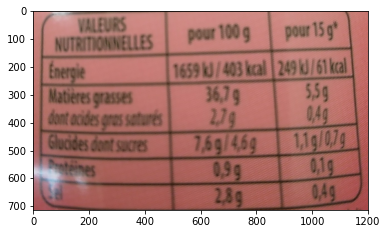

,0,1,2,3
0,VALEURS,pour,100 g pour,15 g* kcal
1,,,kcal 249,k/61
2,NUTRITIONNELLES,1659,kJ/403,"5,59"
3,,,,
4,Energie,,"36,79","0,4g"
5,Matieres grasses,,"2,79 ON m","1,1g/0,79"
6,dont acides,gras satures,"7,6g/4,69 B en","0,19"
7,Glucides dont,sucres,"0,99 e","0,49"
8,Penteines,,"2,89",


26it [00:00, 24385.49it/s]


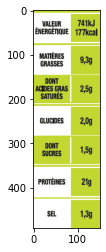

,0,1,2
0,ÉNERGETIQUE VALEUR,741KJ 177kcal,
1,MATIERES GRASSES,"9,3g",
2,DONT ACIDES GRAS SATURES,"2,5g",
3,GLUCIDES,"2,0g",
4,DONT SUCRES,"1,5g",
5,PROTEINES,21g,
6,SEL,"1,3g",


39it [00:00, 17914.56it/s]


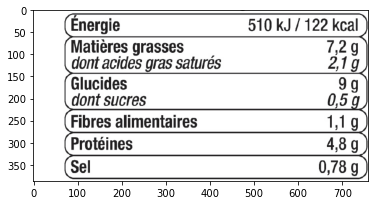

,0,1,2
0,,(Énergie,510 kJ 122 kcal
1,,Matières grasses,"7,2 g"
2,,dont acides gras saturés,"2,1 g"
3,,Glucides,9 g
4,,dont sucres,"0,5 g"
5,,Fibres alimentaires,"1,1 g"
6,,Protéines,"4,8 g"
7,,(Sel,"0,78 g"


An error has occured
An error has occured


30it [00:00, 13145.54it/s]


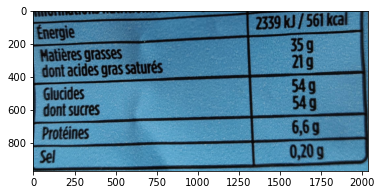

,0,1,2
0,Energie,,2339 kJ/561 kcal
1,Matières grasses dont acides,gras saturés,35 g 21 g
2,Glucides,,54 g
3,dont sucres,,54g
4,Protéines,,"6,6g"
5,Sel,,"0,20g"


30it [00:00, 15584.48it/s]


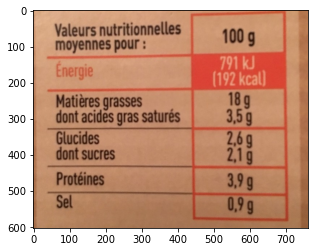

,0,1,2
0,Valeurs moyennes,nutritionnelles pour:,100 g
1,Energie,,791 kJ (192 kcal]
2,Matières dont acides,grasses gras saturés,"18g 3,5g"
3,Glucides,,"2,69"
4,dont sucres,,"2,1 g"
5,Protéines,,"3,9 g"
6,Sel,,"0,9"


50it [00:00, 27924.79it/s]


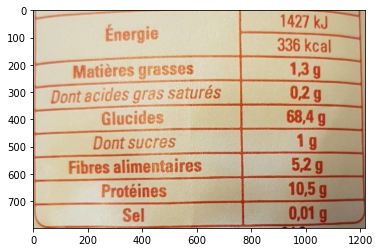

,0,1,2
0,,,1427 kJ
1,Énergie,,336 kcal
2,Matières,grasses,"1,3 g"
3,Dont acides,gras saturés,"0,2 g"
4,Glucides,,"68,4 g"
5,Dont,sucres,1g
6,Fibres,alimentaires,"5,2g"
7,,Protéines,"10,5 g"
8,,Sel,"0,01 g"


148it [00:00, 24501.95it/s]


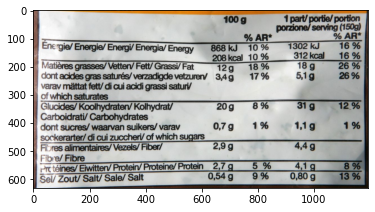

,0,1
0,,1 part/ portie/ portion porzione/ serving (150g) % AR* 100 g % AR*
1,Énergie/ Energie/ Energi/ Energia/,16 % 16 % Energy 868 kJ 10 % 208 kcal 10 % 1302 kJ 312 kcal
2,Matières grasses/Vetten/ Fett/ Grassi/ dont acides saturés/verzadigde,"26 % 26 % 12g 18 g 5,1 g Fat vetzuren 3,4g 18 % 17 %"
3,gras varav mättat fett/di cui acidi grassi of which saturates,saturi
4,Glucides/ Koolhydraten/ Kolhydrat/ Carboidrati/ Carbohydrates,20 g 8 % 31 g 12 %
5,dont sucres/ waarvan suikers/ varav sockerarter/ di cui zuccheri/ of which,"sugars 0,7 g 1% 1,1 g 1%"
6,Fibres alimentaires/Vezels/ Fiber/ Fibre/ Fibre,"2,9 g 4,4 g"
7,Pretéines/Eiwitten/Protein/Proteine/Protein Sel/ Zout/ Salt/ Sale/ Salt,"2,7 g 5 % 9 % 4,1 g 0,80 g 8% 13 % 0,54 g"


87it [00:00, 20001.34it/s]


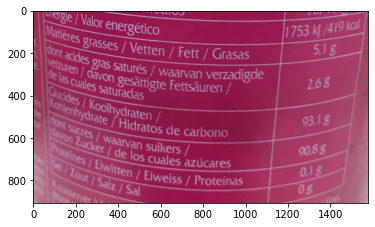

,0,1,2
0,mediOS Cconserver à oog,,1753 kl /419 kcal
1,Energie/ Valor energético,,5.1g
2,Matières grasses/Vetten / Fett/Grasas dont,verzadigde,"2,6g"
3,acides gras saturés/waarvan,,
4,,,
5,vetzuren |,/,
6,dlavon gesättigte Fettsäuren de las cuales saturadas,,"93,1g"
7,Glucides/Koolhydraten/ Kohlenhydrate /Hidratos de carbono,,"90,8g"
8,9ont sucres/waarvan suikers davon Zucker/ de los cuales Proteines/Eiwitten/,azúcares,O.18
9,Eiweiss/Proteínas,,


An error has occured
An error has occured
An error has occured


71it [00:00, 24070.12it/s]


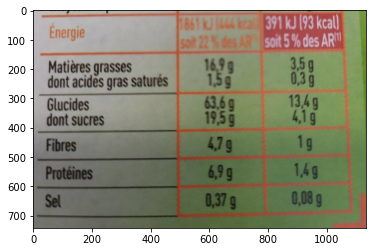

,0,1,2,3
0,Energie,,1861 kJ(444 kcall Sait 22% des AR,391 kJ (93 kcal) soit 5% des AR
1,Matières grasses dont acides gras,saturés,"16.9g 1,5g","3,5g 0,3 g"
2,Glucides dont sucres,,"63,6g 19,5 9","13,4 g 4,19"
3,Fibres,,"4,7 g",1g
4,Proteines,,"6,99","1,4g"
5,Sel,,"0,37 g","0,08 9"


An error has occured
An error has occured
An error has occured
An error has occured


66it [00:00, 21780.02it/s]


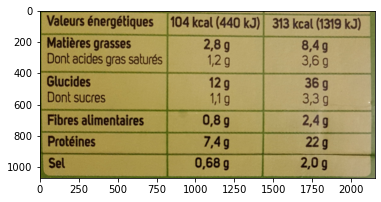

,0,1,2,3,4
0,Valeurs énergétiques,104 kcal,(440 kJ),313 kcal,(1319 kJ)
1,Matières grasses,,"2,8g",,"8,4g 3,6g"
2,,,,,
3,Dont acides gras saturés,,"1,2 g",,
4,Glucides,,12g,,36 g
5,Dont sucres,,"1,1 g",,"3,3g"
6,Fibres alimentaires,,"0,8g",,"2,4g"
7,Protéines,,"7,4 g",,22 g
8,Sel,"0,68",g,,"2,0g"


40it [00:00, 12445.08it/s]


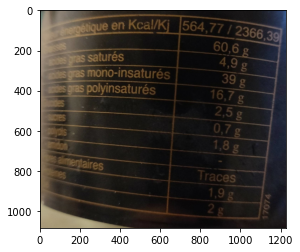

,0,1,2
0,Serergetique,en Kcal/Ki,"564,77 /2366,39"
1,Sesses gras,saturés,"60,6 g 4,9"
2,es,,g
3,des gras,mono-insaturés,39
4,es gras,polyinsaturés,"16,7 g"
5,pes,,"2,5"
6,,,g
7,CTes,,"0,7 g"
8,phyols,,"1,8 g"
9,idom,,


41it [00:00, 8673.79it/s]


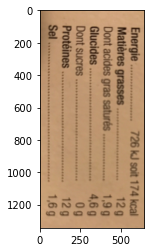

,0,1,2
0,"Energie.. Matières grasses Dont Glucides Dont Protéines Sel 174 kcal 12 g 1,9 g 4,6 g 0g 12 g 1,6 g ***",726,kJ soit
1,,,
2,acides gras,saturés,ee.ccce
3,sucres **,,eecce
4,,,
5,********,,cnnenceee
6,,,
7,,,


An error has occured
An error has occured


32it [00:00, 17763.07it/s]


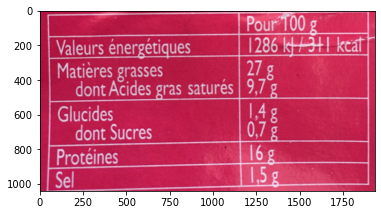

,0,1,2
0,,Pour T00 g,
1,Valeurs énergétiques,1286 kt1311,kcat
2,Matières grasses dont Acides gras saturés,"27 g 9,7g",
3,Glucides dont Sucres,"1.4g 0,7g",
4,Protéines,16 g,
5,Sel,"1,5g",


53it [00:00, 17338.59it/s]


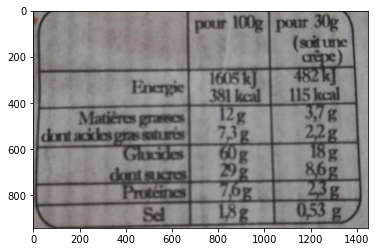

,0,1
0,30g,pour 100g pour (soit une cepe) kJ
1,,
2,,"482 115kcal 3,7g 1605 kJ kcal"
3,,22g 381 12g Energie be
4,,"18g 7,3g"
5,Matières,86g grascs grassaturés bd 382
6,acicles,60g be
7,,23g 29g ad
8,dont,"Gluddes dont sucres 0,53 g bo"
9,,Proteines Sel 18g


An error has occured


212it [00:00, 19354.67it/s]


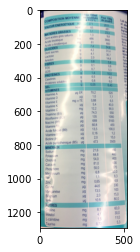

,0,1,2
0,COMPOSITION VALEUR ENERGETIQUE MATIERES GRA8BES Dont acides gras Acide linoléique,MOYENNE keal saturés,"Paur 100m reconatitues Pour 1000 15,6 271 06 3.1 1.3 de poudr Lait de et aliment en bas 2011 An 233 9.8 3600 600 81"
1,Acide linolenique CLUCIDES Dont sucres Lactose Amidon FIBRES FOS GOS,,"648 31,4 30.7 14. 5.9 0.6 63 7,4 4.2 4.1 2.0 VeTWe ait a 0,1 0,7 Veclw"
2,PROTEINES Caseines Proteines solubles SEL VITAMINES Vitamine A Vitamine D Vitamine E Vitamine K Vitamine C Thiamine (B1),ER Pg mg a-TE mg,"10,0 1,4 0,5 0,8 0.05 ém 6,0 0,40 chiorue Aheng decok 70,2 520 7.7 1,0 0.88 5,4 12,2 74,3 6,5 40,0 90,0 550"
3,Riboflavine (B2) Niacine (PP) Vitamine B6 Acide folique (B9) Vitamine B12 Biotine ( Acide pantothenique,(B5) u,"135 689 60,8 13,5 0.16 1000 5100 450 100,0 1,2 15,0 3500 2,0 473"
4,MINERAUX Sodium Potassium Chlorure Calcium Phosphore Magnesium Fer,mg mg,"21,6 160 mg mg mg mg mg 480 64,8 54,0 81.0 50,0 6.8 1,1 400 600 370 50,0 8,3"
5,Zinc Cuivre Manganèse Selenium lode,,"mg 0,65 44,6 13,5 2,0 10,8 4,8 330 100 15,0 80,0"
6,AUTRES Choline Inosito L-carnitine Taurine,,"mg mg mg mg 8,1 41 60,0 30,0 11,0 1,5 0.72 5,3"


44it [00:00, 22083.21it/s]


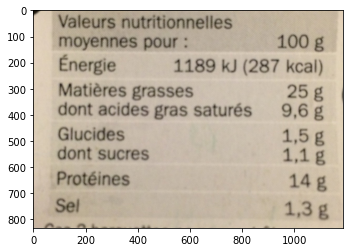

,0,1,2
0,Valeurs moyennes,nutritionnelles pour:,100 g
1,Énergie,1189 kJ (287,kcal)
2,Matières,grasses,25 g
3,dont,acides gras saturés,"9,6 g"
4,Glucides dont,sucres,"1,5 g 1,1 g"
5,Protéines,,14 g
6,Sel,,"1,3 g"


An error has occured


39it [00:00, 17581.45it/s]


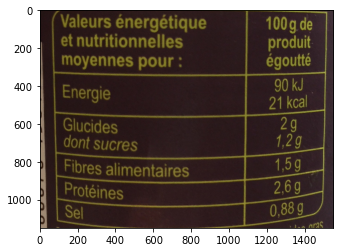

,0,1,2
0,Valeurs et nutritionnelles,énergétique,100g de produit
1,moyennes,pour:,égoutté
2,Energie,,90 kJ 21 kcal
3,Glucides dont sucres,,"2g 1,2 g"
4,Fibres alimentaires,,"1,5g"
5,Proteines,,"2,6g g"
6,Sel,,"0,88"


An error has occured


46it [00:00, 15250.81it/s]


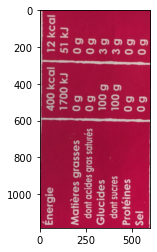

,0,1,2,3
0,12 kcal Énergie Matières dont acides Glucides dont Protéines Sel 51 kJ 0 g 0 g 3 g 3 g 0 g 0 g,,,
1,,,400 1700 0 g,kcal kJ
2,grasses gras,saturés,0 g 100,g
3,,,100,g
4,sucres,,,
5,,,o g 0 g,
6,,,,
7,,,,


93it [00:00, 19146.43it/s]


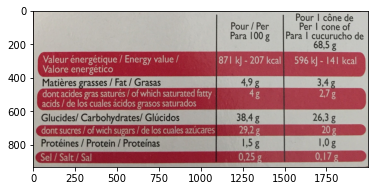

,0,1
0,,Pour/ Per Pour I cône de Per I cone of Para I cucurucho de
1,,"Para 100 g 68,5 g"
2,énergétique / Energy value/,596 k- 141 kcal 871 kJ -207 kcal
3,Valeur energético,"3,4 g"
4,Valore grasses/Fat/Grasas,"4,9 g 2,7g bo"
5,,
6,Matières dont acides gras saturés / of which acids/ de los cuales ácidos grasos Glucides/ Carbohydrates/ Glúcidos,"saturated fatty saturados 4 g 26,3 g 38,4 g 29,2g 20g bo"
7,dont sucres/of wich sugars/de los,"cuales azúcares 1,5g 1,0g"
8,Protéines / Protein / Proteínas,"0,17 g"
9,Sel/Salt/Sal,"0,25g"


63it [00:00, 14510.77it/s]


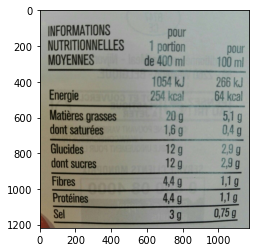

,0,1,2
0,INFORMATIONS,pour,
1,1,portion,pour
2,de NUTRITIONNELLES MOYENNES,400 ml,100 ml
3,Energie,1054 kJ 254 kcal,266 kJ 64 kcal
4,Matières grasses dont saturées,"20 g 1,6 g","5,1 g 0,4 g"
5,Glucides dont sucres,12 g 12 g,"2,9 g 2,9 g"
6,Fibres,"4,4 g","1,1 g"
7,,,"1,1 g"
8,Protéines Sel,"4,4g 3 g","0,75 g"


An error has occured


47it [00:00, 15705.25it/s]


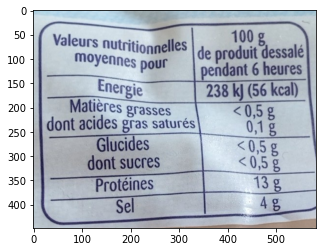

,0,1,2
0,,,
1,Valeurs,nutritionnelles de,100 g produit dessale
2,moyennes,pour,pendant 6 heures
3,,Energie,238 kJ (56 kcal)
4,Matières dont acides,grasses gras saturés,"<0,5 g 0,1 g"
5,,Glucides,"<0,5 g"
6,dont,sucres,"< 0,5 g"
7,,Protéines,13 g
8,,,
9,,Sel,4g


C:\Users\ytremenbert\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:3372: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
65it [00:00, ?it/s]


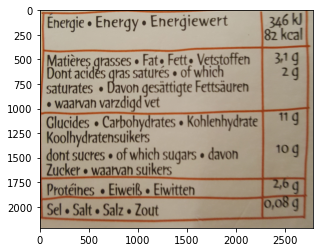

,0,1,2
0,,,
1,,,


66it [00:00, 16382.06it/s]


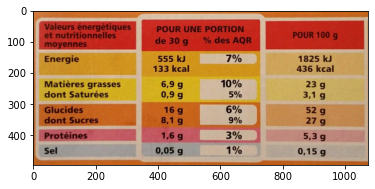

,0,1,2
0,Valeurs énergétiques et nutritionnelles moyennes,POUR UNE de 30 g,PORTION POUR 100 g % des AQR 1825 kJ
1,Energie,555 kJ 133 kcal,436 kcal 7%
2,Matières grasses dont Saturées,"6,9 g 0,9 g","23 g 3,1 g 10% 5%"
3,Glucides dont Sucres,"16 g 8,1 g",52 g 27 g 6% 9%
4,Protéines,"1,6 g","5,3 g 3%"
5,Sel,"0,05 g","0,15 g 1%"


74it [00:00, 15409.52it/s]


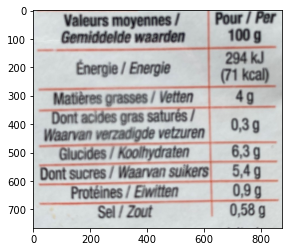

,0,1
0,Valeurs moyennes / Gemiddelde waarden,Pour / Per 100 g
1,Énergie / Energie,294 kJ (71 kcal)
2,Matières grasses / Vetten,4 g
3,,
4,Dont acides gras saturés /,"0,3 g"
5,Waarvan verzadigde vetzuren,
6,Glucides/Koolhydraten,"6,3 g"
7,,
8,Dont sucres / Waarvan suikers,"5,4 g"
9,,


45it [00:00, 21767.23it/s]


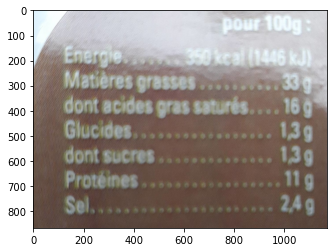

,0,1
0,pour,100g
1,Energie 350 keal,1446 kJ)
2,Matières grasses,33 9
3,,
4,dont acides gras saturés....,16
5,Glucides ***********,"1,39"
6,dont sucres..o*,"1,39 ee e"
7,Proteines.**.**.,. 11 g
8,Sel....,.24g


48it [00:00, 12652.50it/s]


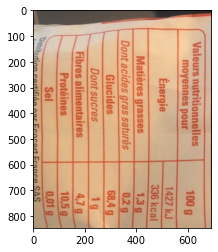

,0,1,2,3
0,g kJ,,,
1,Valeurs,nutritionnelles moyennes pour,,100
2,,Énergie,,1427 336 kcal
3,,Matières grasses,,
4,Dont,acides saturés,,"1,3 g"
5,,gras,,"0,2 g"
6,,Glucides,,"68,4 g"
7,,Dont sucres,,1g
8,Fibres,alimentaires,,"4,7"
9,,Protéines,,g


An error has occured
An error has occured


31it [00:00, 9676.52it/s]


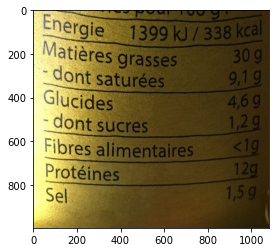

,0,1,2
0,Energie,100 g 1399 kJ/338,kcal
1,Matières,grasses,30 g
2,dont,saturées,"9,19"
3,Glucides,,"4,6 g"
4,-dont sucres,,"1,2 g"
5,Fibres,alimentaires,<19
6,Protéines,,12g
7,Sel,,"1,5g"


32it [00:00, 15006.45it/s]


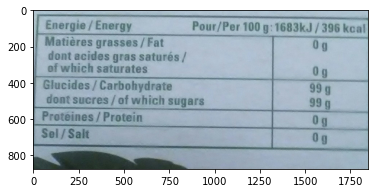

,0,1,2,3
0,Energie/Energy,Pour/Per 100,g:1683kJ/396,kcal
1,Matières,grasses/Fat,0 g,
2,dont acides of which,gras saturés/ saturates,0g,
3,Glucides/ dont sucres/,Carbohydrate of which sugars,99 99,g g
4,Protéines/Protein,,0g,
5,Sel/Salt,,0g,
6,,,,


An error has occured


75it [00:00, 24742.24it/s]


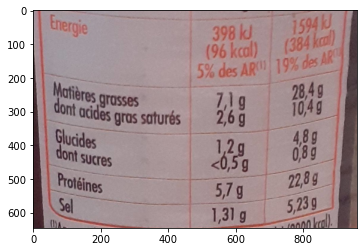

,0,1,2
0,Energie,kcal) 398 kJ,1594 kJ (384 k)
1,,,
2,,(96 5% des AR,19% des AR
3,Matières grasses dont acides gras satures,"7,1 g 2,6g","28,4 g 10.4g"
4,Glucides dont sucres,"1,2g <0,5g","4,8 g 0,8g"
5,Proféines,"5,7 g","22,8g"
6,Sel,"1,31 g","5,23 g kcal)."


37it [00:00, 17856.32it/s]


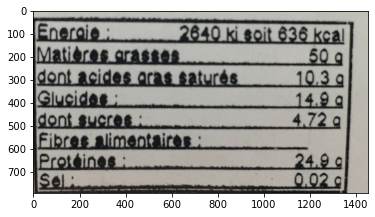

,0,1
0,Eneraie 2640 ki soit,636 kcal
1,Matiores arasses,50 g
2,dont acides aras saturés,10.3 g
3,Glucidas,14.9 q
4,dont sucras,4.72 a
5,Fibres alimentaires,
6,Prottines,24.9 q
7,Seli,9.02 g


An error has occured


31it [00:00, 24583.74it/s]


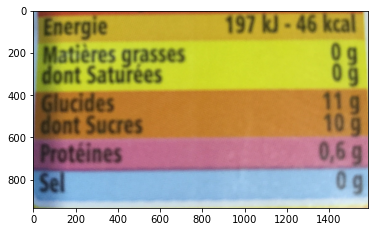

,0,1
0,Energie,197 kJ - 46 kcal
1,Matières grasses dont Satures,0 g 09
2,Glucides,11 g 10 g
3,dont Sucres,
4,Protéines,"0,6g"
5,Sel,0g


73it [00:00, 16214.81it/s]


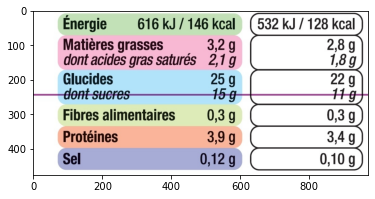

,0,1,2
0,Énergie,616 kJ /,532 kJ / 128 kcal 146 kcal
1,Matières,grasses,"2,8 g 3,2 g"
2,,saturés,"1,8 g"
3,dont acides,gras,"2,1 g"
4,Glucides,,22 g 11g 25 g 15g
5,dont sucres,,
6,Fibres,alimentaires,"0,3 g 0,3 g"
7,Protéines,,"3,4 g 3,9 g"
8,Sel,,"0,10 g 0,12 g"


35it [00:00, 17453.41it/s]


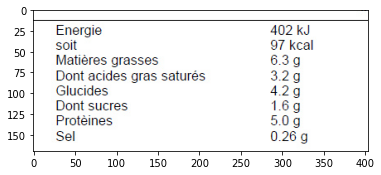

,0,1,2
0,,,
1,Energie,,402 kJ
2,soit,97,kcal
3,Matières,grasses,6.3 g
4,Dont acides,gras saturés,3.2 g
5,Glucides,,4.2 g
6,Dont sucres,,1.6 g
7,Protèines,,5.0 g
8,Sel,,0.26 g


73it [00:00, 17555.43it/s]


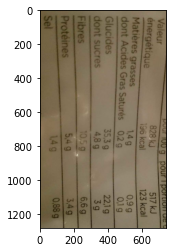

,0,1
0,"portion de Valeur Matières dont dont Fibres 517 kJ 123 kcal 0,9 g 0,1 g 22,1 g 3 g 6,6 g 3,4 g 0,88 9 Sel",
1,,pour 100 g pour 1
2,énergétique,828 kJ 196 kcal
3,grasses Acides Gras,"Saturés 1,4 g 0,2 g"
4,Glucides sucres,"35,3 g 4,8 g"
5,Protéines,"10,5 g 5,4 g"
6,,"1,4 g"
7,,


28it [00:00, 6590.75it/s]


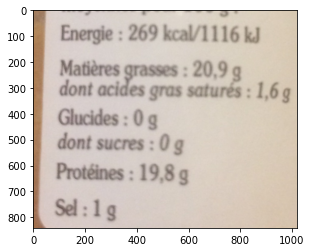

,0,1
0,Energie: 269,kcal/1116 k
1,Matières,"grasses: 20,9g"
2,dont acides,"gras saturés: 1,6g"
3,Glucides:0g,
4,dont sucres:0,g
5,Protéines:,"19,8 g"
6,Sel : 1 g,


32it [00:00, 13824.05it/s]


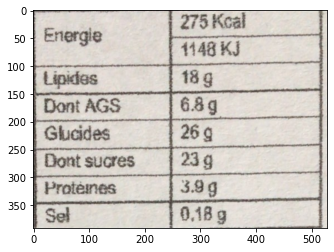

,0,1,2
0,,,275 Kcal
1,Energie,,1148 KJ
2,Lipides,,18 g
3,Dont,AGS,6.8 g
4,Glucides,,26 g
5,Dont,sucres,23 g
6,Proténes,,3.9 g
7,Sel,,0.18 g


An error has occured
An error has occured


68it [00:00, 17064.30it/s]


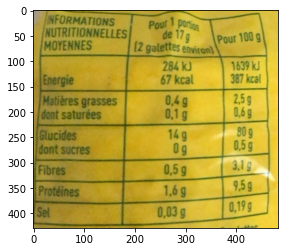

,0,1,2
0,INFORMATIONS NUTRITIONNELLES ΜΟΥΕΝNES,Pour 1 portion de 17 g [2 galettes enviran) Pour,100 g
1,Energie,284 kJ 67 kcal,1639 kJ 387 kcal
2,Matières grasses dont saturées,"0,4 g 0,1 g","2,5g 0,6 g"
3,Glucides dont sucres,14 9 0g,"80 g 0,5 g 86"
4,Fibres,"0,5 g","3,1g 9,5g"
5,Protéines,"1,6g",
6,Sel,"0,03 g","0,19 g"


37it [00:00, 14194.57it/s]


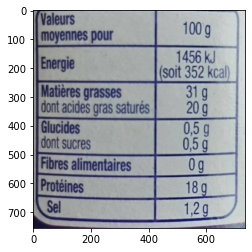

,0,1
0,Valeurs moyennes pour,100g
1,Energie,1456 kJ (soit 352 kcal)
2,Matières grasses dont acides gras saturés,31 g 20 g
3,Glucides dont sucres,"0,5g 0,5 g"
4,Fibres alimentaires,0g
5,Protéines,18 g
6,Sel,"1,2 g"


42it [00:00, 42113.50it/s]


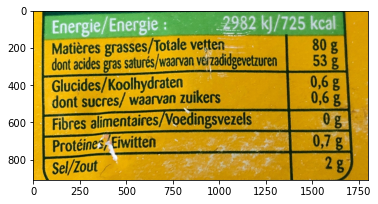

,0,1,2
0,Energie/Energie:,2982 kJ/725,kcal
1,Matières grasses/Totale,vetten,80g
2,,verzadidgevetzuren,53 g
3,dont acides gras saturés/waarvan,,
4,Glucides/Koolhydraten dont sucres/ waarvan,zuikers,"0,6 g 0,6g"
5,Fibres alimentaires/Voedingsvezels,,0g
6,"Protéines, Eiwitten",,"0,7g"
7,Sel/Zout,,28


47it [00:00, 23549.43it/s]


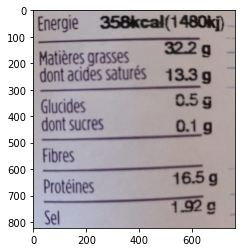

,0,1,2
0,Energie,358kcal,(1480k)
1,Matières,grasses,322 g
2,dont acides,saturés,13.3g
3,Glucides,,0.5 g
4,dont sucres,,0.1 g
5,Fibres,,
6,Proteines,,16.5 g
7,Sel,,1.92 g


51it [00:00, 12983.10it/s]


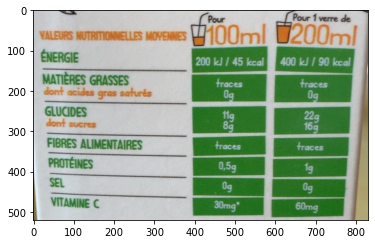

,0,1,2,3
0,,,Pour 100ml,Pour 1 verre de 1200ml
1,VALEURS NUTRITIONNELLES,MOVENNES,,
2,ÉNERGIE,,200 kJ / 45 kcal,400 kJ/ 90 kcal
3,MATIÈRES GRASSES dont acides gras,saturés,traces Og,traces 0g
4,GLUCIDES dont sucres,,11g 8g,22g 16g
5,FIBRES ALIMENTAIRES,,traces,traces
6,PROTÉINES,,"0,5g",1g
7,SEL,,0g,Og
8,VITAMINE C,,30mg,60mg


An error has occured
An error has occured


32it [00:00, 13156.02it/s]


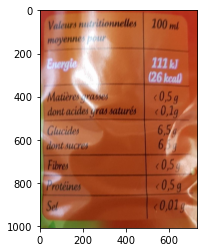

,0,1,2
0,Valeurs moyenne pour,nutritionnelles,100 ml
1,Energie,,111 kJ (26 kcal)
2,Matières rasses dont acides yras,saturés,"<0,5 g 0,1g"
3,Glucides dont sucres,,"6,5 60g"
4,,,
5,Fibres,,"<0,5"
6,Protéines,,"<0,5 g"
7,Sel,,"0,01g"


34it [00:00, 16749.63it/s]


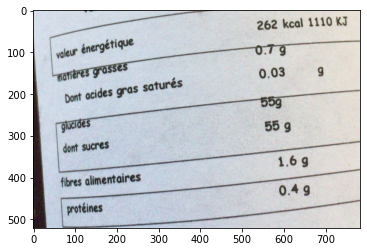

,0,1,2
0,valeur,énergétique,262 kcal 1110 KJ
1,matières,grasses,0.79
2,Dont acides,gras saturés,0.03
3,glucides dont sucres,,559 55 9
4,fibres alimentaires,,1.6 g
5,protéines,,0.4 g


40it [00:00, 8100.24it/s]


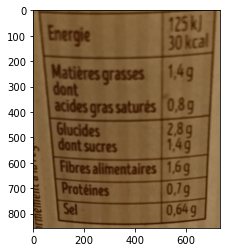

,0,1
0,Energie,125 k 30 kcal
1,Matieres grasses,"1,4g"
2,,
3,dont acides gras saturés,"0,8g"
4,Glucides dont sucres,"2,8g 1,4g"
5,Fibres alimentaires,"1,6g"
6,Proteines,"0,79"
7,Sel,"0,64g"


C:\Users\ytremenbert\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:3372: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
85it [00:00, 84743.48it/s]


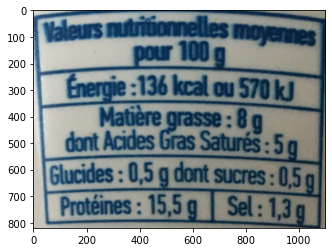

,0,1
0,,
1,,


34it [00:00, 15799.51it/s]


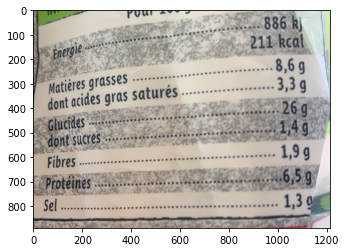

,0,1
0,Pour,886 k
1,Energie,211 kcal
2,,"8,69"
3,Matières grasses dont acides gras saturés,"3,3 g"
4,Glucides dont sucres..,"26 g 1,4 g"
5,Fibres,"1,9 g"
6,Protéines,"6,59"
7,Sel..,"1,3g"


An error has occured
An error has occured


C:\Users\ytremenbert\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:3372: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
71it [00:00, 71157.85it/s]


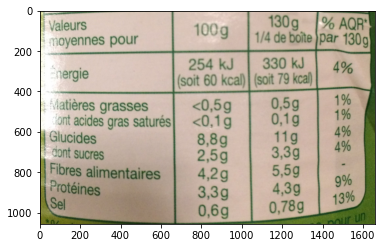

,0,1,2
0,,,
1,,,


35it [00:00, 32031.56it/s]


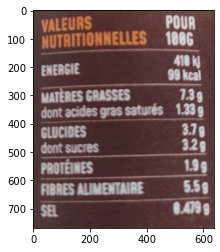

,0,1
0,VALEURS NUTRITIONNELLES,POUR 100G
1,ENERGIE,410 K 99 kcal
2,dont acides MATÈRES,1.3g gras saturés 1.33 g GRASSES
3,GLUCIDES dont sucres,3.7g 3.2g
4,PROTÉINES,1.9g
5,FIBRES,ALIMENTAIRE 5.59
6,SEL,8.479 9


66it [00:00, 12571.48it/s]


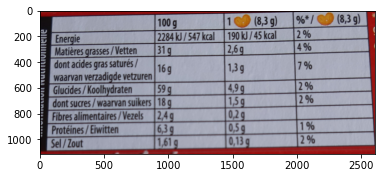

,0,1,2,3
0,,100 g,"1 (8,3 g)","(8,3 g)"
1,Energie,2284 kJ/547 kcal190,kJ/45 kcal,2 %
2,,,,%
3,Matières grasses/Vetten,31q,"2,6g",4
4,dont acides gras saturés/ waarvan verzadigde vetzuren,16g,"1,3 g",7 %
5,Glucides/Koolhydraten,59 g,"4,9 g",2 %
6,,,,
7,dont sucres/waarvan suikers,18 g,"1,5g",2 %
8,Fibres alimentaires/Vezels,"2,4g",02g,
9,,,,


45it [00:00, 29149.60it/s]


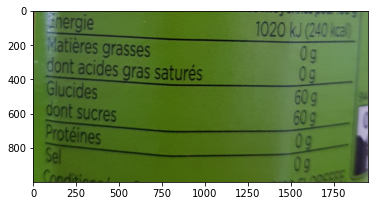

,0,1,2
0,g Sel kcal) Conditionné,1020 kJ (240 0g O0,
1,hergie,,60g O O)
2,Matières grasses dont acides,gras saturés,60g Og 0
3,,,c
4,Glucides,,09
5,sucres,,
6,dont Protéines,,


35it [00:00, 8592.37it/s]


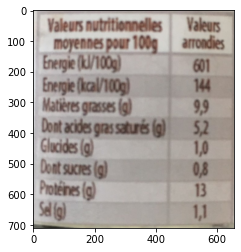

,0,1,2,3
0,Valeurs moyennes,nutritionnelles pour 100g,,Valeurs arrondies
1,Energie,(k/1009),,601
2,Energie,(kcal/100g),,144
3,Matieres,grasses (g),,"9,9"
4,Dont acides,gras satures (g),,52
5,Glucides (g),,,"1,0"
6,Dont sucres,(g),,"0,8"
7,Proteines (,,,13
8,,,,"1,1"


C:\Users\ytremenbert\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:3372: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
25it [00:00, ?it/s]


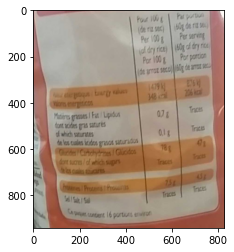

,0,1
0,,
1,,


29it [00:00, 29009.02it/s]


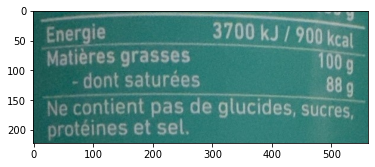

,0,1,2
0,Energie,3700 kJ/900,g kcal
1,grasses,,100 g
2,Matières -dont saturées,,88 g
3,Ne contient,"pas de glucides,","sucres,"
4,protéines et,sel.,


51it [00:00, 43996.20it/s]


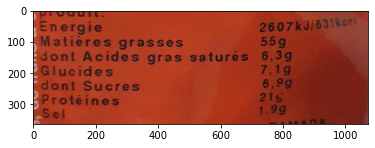

,0,1,2
0,produit:,,
1,Energie,,2607kJ/631keeil
2,Matières,grasses,55g
3,dont Acides,gras saturés,"6,3g"
4,,,
5,PGlucides,,"7,1g 6,9g"
6,Edont,,
7,Sucres,,
8,Protéines,,21s
9,Sel,,1.9g


30it [00:00, 15042.33it/s]


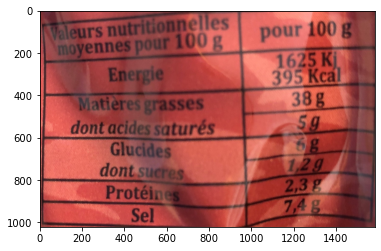

,0,1,2
0,Valeurs moyennes,nutritionnelles pour 100 g,pour 100 g
1,,Energie,1625 Ki 395 Kcal
2,,Matieres grasses,38g
3,dont,acides satures,$9
4,,Glucides,68
5,,dont sucres,"1,2g"
6,,Protéines,"2,3g"
7,,Sel,"7,4g"


30it [00:00, 15035.14it/s]


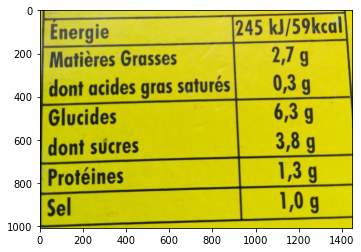

,0,1,2,3
0,Energie,,|245,kJ/59kcal
1,Matières Grasses,,"2,7",g
2,|dont acides gras,saturés,,"0,3 g"
3,Glucides,,,"6,3 g"
4,dont sucres,,,"3,8 g"
5,Protéines,,,"1,3 g"
6,Sel,,,"1,0 g"


An error has occured


84it [00:00, 13971.03it/s]


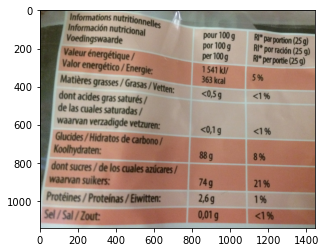

,0,1,2,3
0,Informations,nutritionnelles,,
1,Información Voedingswaarde,nutricional,pour 100 g por 100 g per 100 g,Ri* par portion (25 g) RI* por ración (25 g) Ri* per portie (25 g)
2,Valeur énergétique Valor Matières,/ energético/Energie: grasses/Grasas/Vetten:,1 541 kJ/ 363 kcal,5%
3,,,"<0,5 g",<1%
4,dont acides gras de las cuales waarvan Glucides/Hidratos,saturés/ saturadas/ verzadigde vetzuren: de carbono/,"<0,1 g",<1%
5,Koolhydraten:,,88 g,8 %
6,dont sucres/de waarvan suikers:,los cuales azúcares/,74g,21%
7,,,,1 %
8,Protéines/Proteínas/Eiwitten:,,"2,6g",
9,Sel/Sal/Zout:,,"0,01 g",<1%


175it [00:00, 23243.40it/s]


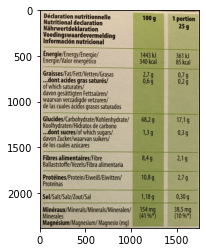

,0,1,2,3
0,Déclaration Nutritional declaration Nahrwertdeklaration Voedingswaardevermelding Informacion nutricional,nutritionnelle,100 g,1 portion 25 g
1,Energie/Energy/Energie/ Energie/Valor energético,,1443 kJ 340 kcal,361 85 kcal
2,Graisses/Fat/Fett/Vetten/Grasas dont acides gras,saturés/,"2,7 g 0,6 g","0,7 g 0,2 g"
3,of which saturates/ davon gesattigten,Fettsauren/,,
4,waarvan verzadigde de las cuales acidos,vetzuren/ grasos saturados,,
5,Glucides/Carbohydrate/Kohlenhydrate/ Koolhydraten/Hidratos dont sucres/of which davon Zucker/waarvan de los cuales azucares,de carbono sugars/ suikers/,"68,2 g 1,3 g","17,1 g"
6,Fibres alimentaires/Fibre Ballaststoffe/Vezels/Fibra,alimentaria,"8,4 g","2,1 g"
7,,,,
8,Protéines/Protein/Eiwei3/Eiwitten/ Proteinas,,"10,8 g","2,7 g"
9,Sel/Salt/Salz/Zout/Sal,,"1,18 g","0,30 g"


31it [00:00, 13165.60it/s]


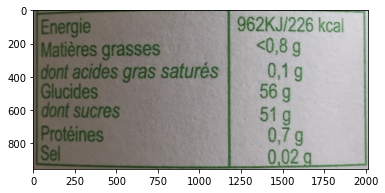

,0,1,2,3
0,Energie,,"962KJ/226 <0,8",kcal g
1,Matières,grasses,,
2,,,,
3,,saturés,"0,1",g
4,,,,
5,dont acides Glucides,gras,56,9
6,dont sucres,,51,g
7,,,,"0,7 g"
8,Protéines Sel,,,"0,02 g"


40it [00:00, 20063.64it/s]


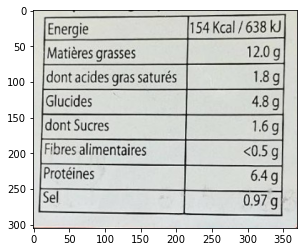

,0,1,2
0,Energie,154 Kcal,/638 kJ
1,Matières grasses,,12.0 g
2,dont acides gras saturés,,1.8 g
3,Glucides,,4.8 g
4,dont Sucres,,1.6 g
5,Fibres alimentaires,,<0.5 g
6,Protéines,,6.4 g
7,Sel,,0.97 g


An error has occured


74it [00:00, 23820.30it/s]


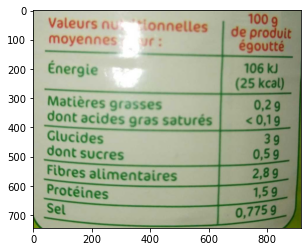

,0,1,2
0,Valeurs n moyennes,tonnelles Jr:,100 9 de produit égoutté
1,Energie,,106 kJ (25 kcal)
2,grasses,,"0,29"
3,dont acides gras,saturés,"0,19"
4,Glucides dont sucres,,"3 g 0,5 g"
5,Fibres alimentaires,,"2,8 g"
6,,,
7,Protéines,,"1,5 g"
8,Sel,,"0,7759"


59it [00:00, 34868.81it/s]


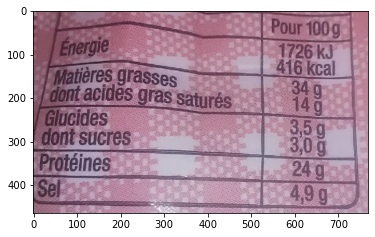

,0,1,2
0,,,Pour 100g
1,Energie,,1726 kJ 416 kcal
2,Matières grasses,,34 g
3,dont acides,gras saturés,14 g
4,Glucides dont sucres,,"3,5g 3,0 g"
5,Protéines,,24 g
6,Sel,,"4,9 g"


39it [00:00, 20085.69it/s]


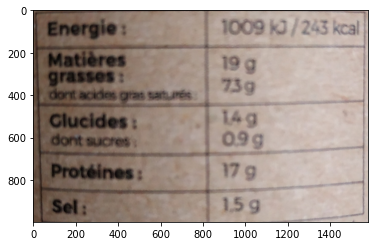

,0,1
0,Energie:,1009 kJ/243 kcal
1,Matières,19 g
2,grasses: dont acides gras saturés.,7.3
3,Clucides: dont sucres:,1.4g 099
4,Protéines:,17 9
5,Sel:,15 g


41it [00:00, 19190.54it/s]


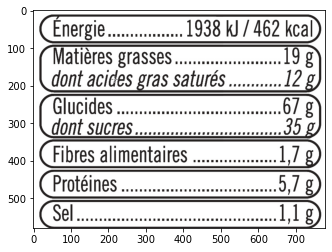

,0,1
0,Energie..,1938 kJ/ 462 kcal)
1,Matières,.19 g grasses...
2,dont,acides gras saturés ..........12 g)
3,Glucides...,.67 g
4,dont,..35 g) sucres..
5,Fibres,"alimentaires .... ......,7 g"
6,Protéines...,"...,7 g"
7,Sel..,".1,1 g 7"


29it [00:00, 24752.71it/s]


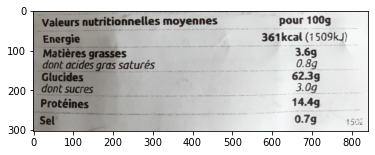

,0,1,2,3
0,Valeurs,nutritionnelles moyennes,,pour 100g
1,Energie,,361kcal,(1509KJ)
2,Matières grasses dont acides gras,saturés,,3.6g 0.8g
3,Glucides,,,62.39
4,dont sucres,,,3.0g
5,Protéines,,,14.4g
6,Sel,,,0.7g 1502


21it [00:00, 17407.19it/s]


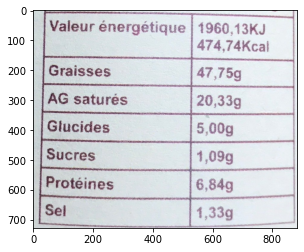

,0,1
0,Valeur énergétique,"1960,13KJ"
1,,"474,74Kcal"
2,Graisses,"47,75g"
3,AG saturés,"20,33g"
4,Glucides,"5,00g"
5,Sucres,"1,09g"
6,Protéines,"6,84g"
7,Sel,"1,33g"


An error has occured


39it [00:00, 11666.63it/s]


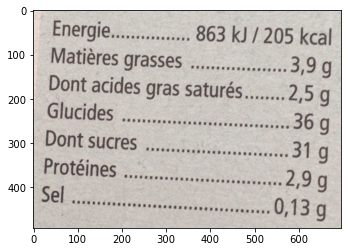

,0,1
0,Energie. . 863 kJ / 205,kcal
1,"...3,9 .",g
2,Matières grasses ..,
3,Dont acides gras saturés.,".2,5 g"
4,Glucides ..,.36 g
5,Dont sucres,31 g
6,Protéines,"2,9 g"
7,Sel,"0,13 g"
8,...,


39it [00:00, 15233.55it/s]


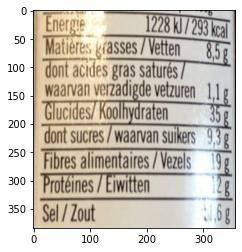

,0,1,2
0,Energie,,1228 KJ/293 kcal
1,Matières,grasses/,"Vetten 8,5g"
2,dont acides,gras,saturés /
3,,,
4,waarvan,verzadigde,"vetzuren 1,1g"
5,Glucides/Koolhydraten,,35
6,dont,,"sucres/waarvan suikers 9,3g"
7,Fibres,,alimentaires/Vezels 19
8,Protéines/Etwitten,,
9,Sel / Zout,,


72it [00:00, 15795.28it/s]


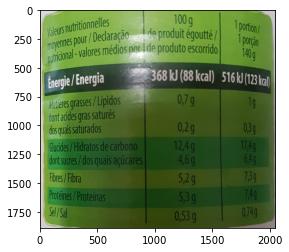

,0,1,2
0,Valeurs nutritionnelles,100 de produit,g égoutté/ 1portion/ égoutté/
1,moyennes pour/ nitridional-valores,Declaraçaceproduit médios nor i de produto,1 porGo 140g escorrido
2,Energie/Energia,368 kJ,(88 kcal) 516kJ (123 kall
3,Matieres dont acides gras dos quais saturados,"0,7 grasses/Lipidos saturés","g 19 039 0,2g"
4,Glucides/Hidratos dont sucres/dos,"de carbono quais açucares 12,4g","17,49 6,49 4,6g"
5,,,739
6,Fibres/Fibra,,"5,2g"
7,Protéines/Proteinas Sel/Sal,"0,53","5,3g 0,74g g"


An error has occured


54it [00:00, 18045.77it/s]


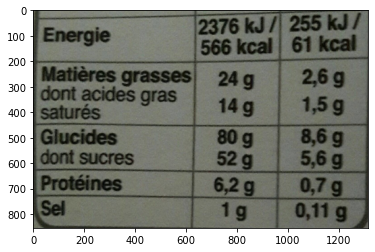

,0,1,2,3
0,Energie,,2376 kJ/ 566 kcal,255 kJ/ 61 kcal
1,Matières,grasses,24 g,"2,6 g"
2,dont saturés,acides gras,14 g,"1,5 g"
3,Glucides,,80 g,"8,6 g"
4,dont,sucres,52 g,"5,6 g"
5,Protéines,,"6,2 g","0,7 g"
6,Sel,,1g,"0,11 g"


26it [00:00, 26064.03it/s]


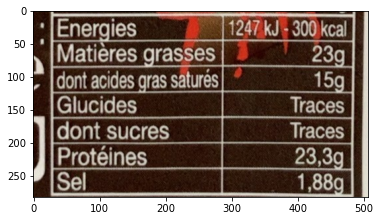

,0,1
0,ET: Energies 1247,kJ-300 kcal
1,Matières grasses,23g
2,edont acides gras saturés,15g
3,Glucides,Traces
4,dont sucres,Traces
5,Protéines,"23,3g"
6,Sel,"1,88g"


96it [00:00, 34265.44it/s]


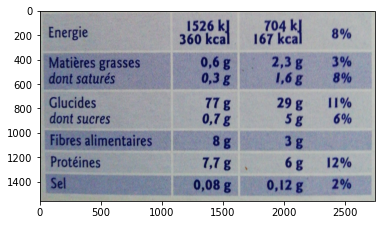

,0,1,2
0,Energie,704 k 1526 360 kcal 167 kcal,8% 3%
1,Matières grasses dont saturés,"2,3 g 1,6 g 0,6 g 0,3 g",8%
2,Glucides dont sucres,"29 g 5 g 77 g 0,7 g",11% 6%
3,Fibres alimentaires,3 g 8 g,
4,,,
5,Protéines,"6g 7,7 g",12%
6,Sel,"0,08 g 0,12 g",2%


An error has occured
An error has occured
An error has occured


71it [00:00, 64235.46it/s]


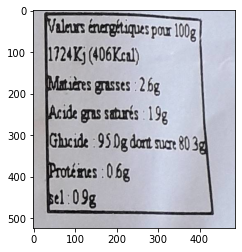

,0,1
0,Valars,énergitiques pour 100g
1,1724K),(406Kcal)
2,Matscres,grasses 2 bg
3,Acide gras,saburés 19g
4,Ghacide,950g dart suare 80 3g
5,Protéines,:0 6g
6,sel:09g,


149it [00:00, 16936.81it/s]


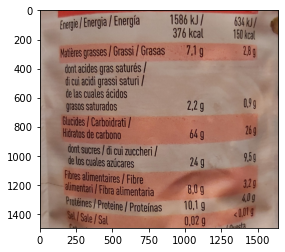

,0,1,2
0,Energie / Energia,/ Energía 1586 kJ/ 376kcal,634 kJ/ 150 kcal
1,Matières,"grasses/Grassi/ Grasas 7,1 g","2,8g"
2,dont acides di cui acidi de las cuales grasos saturados,"gras saturés / grassi saturi / ácidos 2,2 g","0,9g"
3,Glucides/Carboidrati Hidratos de,/ carbono 64 g,26 g
4,dont sucres de los cuales,/ di cui zuccheri/ azúcares 24,"g 9,5g"
5,,,
6,Fibres alimentari /,"alimentaires/Fibre Fibra alimentaria 8,0g","3,2g"
7,,,"4,0g"
8,Protéines/Proteine/ Sel/Sale/Sal,"Proteínas 10,1 0,02","g <0,01 g g Questa"


69it [00:00, 32905.85it/s]


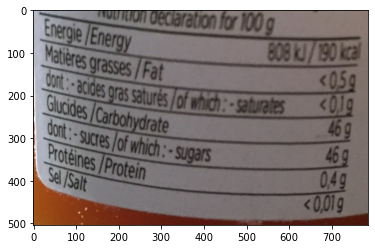

,0,1
0,Nutrition declaration,for 100g 808KJ/ 190 kcal
1,Energie /Energy,<05g
2,Matières grasses/Fat,<0.1g
3,dont:-acides gras saturéés,/of which : - saturates 46g
4,Glucides/Carbohydrate,46g
5,dont:-sucres/of,which:-sugars 10
6,Proteines/Protein,"<0,01g"
7,Sel /Salt,


An error has occured


32it [00:00, 10172.63it/s]


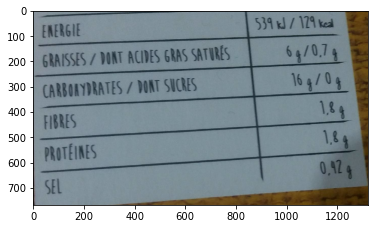

,0,1,2
0,ENERGIE,,539 kJ/129 keal
1,GRAISSES/ DONT ACIDES GRAS,SATURĖS,"6g/0,7"
2,CARBOAYDRATES/ DONT SUCRES,,16 g/0g
3,FIBRES,,"1,8g"
4,PROTEINES,,1.84
5,SEL,,"0,42 4"


An error has occured


98it [00:00, 21065.02it/s]


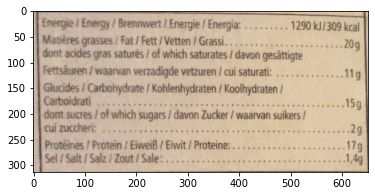

,0,1
0,Energie /Energy/Brennwert /Energie /Energia: ... ..,1290 kJ/309 kcal
1,Matières grasses/ Fat /Fett/Vetten/ Grassi.....,....20g
2,dont acides gras saturės / of which saturates / davon gesättigte,
3,Fettsäuren / waarvan verzadigde vetzuren / cui saturati:,.11g
4,Glucides/Carbohydrate / Kohlenhydraten / Koolhydraten /,
5,Carboidrati ...,......15g
6,dont sucres / of which sugars / davon Zucker/waarvan suikers cui zuccheri: ...,/ ..2g
7,/ Eiweiß /Eiwit/Proteine:....,
8,Protéines/Protein Sel/Salt/Salz/Zout /Sale: ....,".17g .1,4g"


An error has occured
An error has occured
An error has occured


94it [00:00, 14047.77it/s]


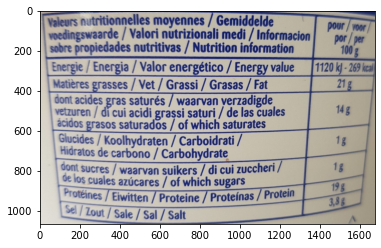

,0,1,2
0,Valeurs nutritionnelles /Valori,moyennes/Gemiddelde nutrizionali medi / Informacion,pour/voor
1,Voedingswaarde sobre propiedades nutritivas,/ Nutrition information,por/per 100g
2,Energie/Energia/Valor,energético/ Energy value,1120 kJ-269 kcal
3,Matières grasses/Vet/,Grassi/ Grasas/ Fat,21 g
4,,,
5,dont acides gras saturés vetzuren / di cui acidi ácidos grasos saturados,/ waarvan verzadigde grassi saturi / de las cuales / of which saturates,14g
6,Glucides/Koolhydraten Hidratos de carbono /,/ Carboidrati / Carbohydrate,1 g
7,dont sucres/waarvan de los cuales azúcares,suikers/di cui zuccheri/ /of which sugars,1g 19 g
8,Proteines/Eiwitten /,Proteine / Proteínas /Protein,"3,8g"
9,Sel/Zout/Sale/,Sal/Salt,


An error has occured
An error has occured


37it [00:00, 13477.14it/s]


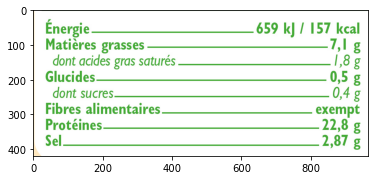

,0,1
0,Energie,".659 kJ/ 157 kcal 7,1"
1,,g
2,Matières acides,"1,8 g grasses saturés."
3,dont,".0,5 g gras"
4,Glucides dont sucres.,"0,4 g"
5,,exempt
6,Fibres,"22,8 g alimentaires"
7,Protéines,"2,87 g"
8,Sel,


34it [00:00, 30226.01it/s]


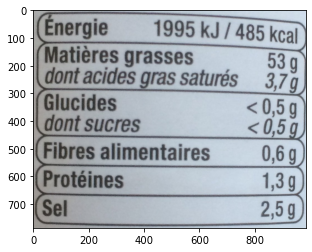

,0,1
0,Energie 1995 kJ/,485 kcal
1,Matières grasses,53 g
2,dont acides gras saturés,"3,7g"
3,Glucides,"<0,5 g"
4,dont sucres,"<0,5g"
5,Fibres alimentaires,"0,6g"
6,Protéines,"1,3 g"
7,Sel,"2,5g"


54it [00:00, 17010.32it/s]


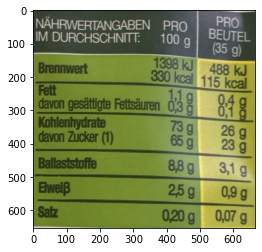

,0,1,2
0,NÄHRWERTANGABEN IM DURCHSCHNITT:,PRO 100 g,PRO BEUTEL (35 g)
1,Brennwert,1398 kJ 330 kcal,488 kJ 115 kcal
2,Fett davon gesättigte,"1,1g Fettsäuren 03","0,4 g 0,1 g"
3,Kohlenhydrate davon Zucker,(1) 73g 65 g,26 g 23 g
4,Ballaststoffe,"8,8 g","3,1 g"
5,Elweiß,"2,5g","0,9 g"
6,Salz,"0,20","g 0,07 g"


An error has occured


131it [00:00, 47580.00it/s]


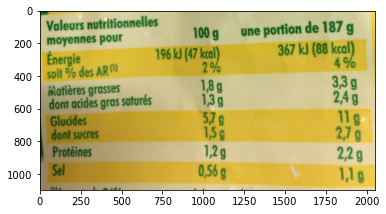

,0,1,2
0,Valeurs nutritionnelles pour,une 100 g,portion de 187 g
1,moyennes Energie soit % des AR),196KJ (47 kcal) 2%,367 kJ (88 kcal) 4%
2,Ratières grasses dont acides gras saturés,"1,8g 1,3 g","3,3g 2,4g"
3,Glucides dont sucres,"5,7 8 1,5g","11 g 2,7"
4,Protéines,"1,2g","2,2 g"
5,Sel,"0,56 g","1,1 g"


40it [00:00, 20345.88it/s]


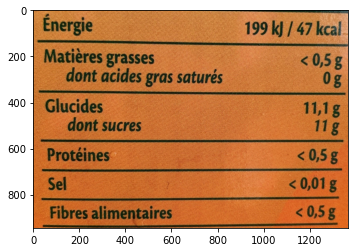

,0,1
0,Énergie,199 k) / 47 kcal
1,Matières,"grasses < 0,5 g"
2,dont acides,gras saturės 0g
3,Glucides,"11,1g"
4,,
5,dont sucres,11g
6,Protéines,"< 0,5 g"
7,Sel,"< 0,01 g"
8,Fibres,"alimentaires < 0,5 g"


37it [00:00, 14833.61it/s]


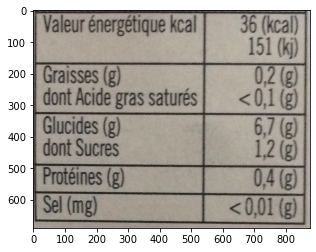

,0,1,2,3
0,Valeur,énergétique kcal,36,(Kcal)
1,,,151,(kj)
2,Graisses,(g),,"0,2(g"
3,dont Acide,gras saturés,"<0,1",(g)
4,Glucides,(g),,"6,7 ( g"
5,dont Sucres,,,12 @
6,Protéines,(g),,"0,4 (g)"
7,Sel (mg),,"<0,01",(g)


64it [00:00, 15650.39it/s]


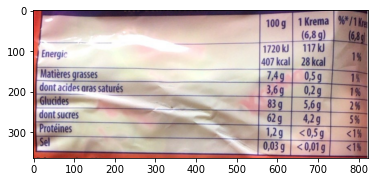

,0,1,2
0,,100 g,"1 Krema %*/1 Kre (6,8 g) (6,8g"
1,Energic,1720 kJ 407 kcal,117 kJ 28 kcal 1%
2,Matières grasses,"1,4g","0,5 g 1%"
3,,,
4,dont acides aras saturés,"3,6g","1% 0,2 g"
5,Glucides,83 g,"2% 5,6g"
6,dont sucres,62 g,"5% 4,2g"
7,Protéines,"1,2 g","<1% <0,5 g"
8,,,
9,Sel,"0,03 g","<1% <0,01 g"


70it [00:00, 14667.60it/s]


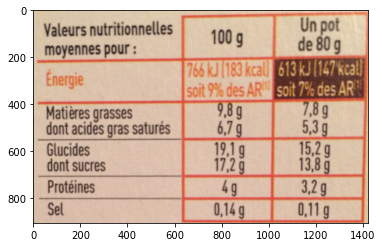

,0,1,2,3,4
0,Valeurs moyennes,nutritionnelles pour:,100,g,Un pot de 80 g
1,Energie,,766 kJ(183,kcall,613 kJ[147 kcal
2,,,soit 9%,des AR,soit 7% des AR
3,Matières dont acides,grasses gras saturés,"9,8 6,7",g g,"7,8 g 5,3g"
4,Glucides dont sucres,,"17,2",19.1g g,"15,2 g 13,8 g"
5,Proteines,,,4g,"3,2 g"
6,Sel,,,"0,14g","0,11 g"


43it [00:00, 24652.14it/s]


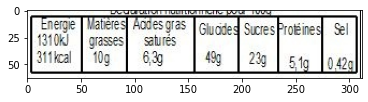

,0,1,2,3
0,,,,
1,,,,
2,Energie Matieres Aodes gras 1310k) grasses saturės,Gluaides,Sucres Proteines,Sel
3,"6,39 311kcal | 10g",49g,239,
4,,,"| 5,19",042g


An error has occured


19it [00:00, 8999.64it/s]


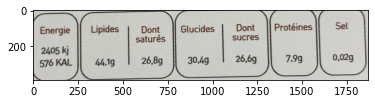

,0,1,2,3,4,5,6
0,,,,,,,
1,Energie,Lipides,Dont,Glucides,Dont,Protéines,Set
2,,,saturés,,sucres,,
3,2405 kj 576 KAL,"44,1g","26,8g","30,4g","26,6g",7.99,"0,02g"
4,,,,,,,


66it [00:00, 12230.99it/s]


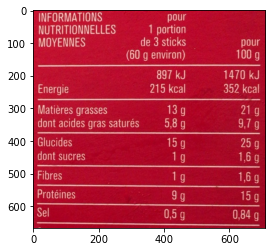

,0,1,2
0,INFORMATIONS NUTRITIONNELLES,pour 1 portion,
1,ΜΟΥΕΝNES,de 3 sticks,pour
2,,(60 g environ),100 g
3,Energie,897 kJ 215 kcal,1470 kJ 352 kcal
4,Matières grasses dont acides gras saturés,"13 g 5,8 g","21 g 9,7 g"
5,Glucides dont sucres,15 g 1g,"25 g 1,6 g"
6,,,"1,6 g"
7,Fibres,1g,
8,Protéines,9 g,15 g
9,Sel,"0,5 g","0,84 g"


39it [00:00, 13026.83it/s]


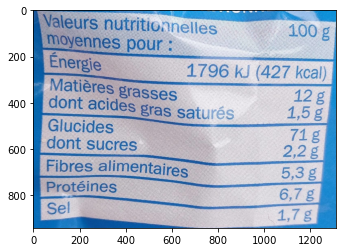

,0,1,2
0,Valeurs,nutritionnelles,100 g
1,moyennes,pour:,
2,Énergie,1796 kJ,(427 kcal)
3,Matières,grasses,12 g
4,dont,acides gras saturés,"1,5 g"
5,Glucides dont,sucres,"71g 2,2 g"
6,Fibres,alimentaires,"5,3 g"
7,Protéines,,"6,7 g"
8,Sel,,"1,7 g"


67it [00:00, 15709.88it/s]


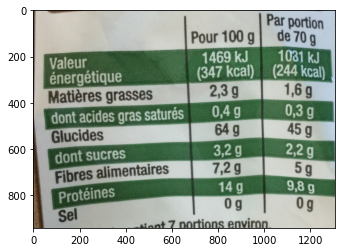

,0,1,2
0,,Pour 100 g,Par portion de 70 g
1,Valeur énergétique,1469 kJ (347 kcal),1031 kJ (244 kcal)
2,Matières grasses,"2,3 g","1,6 g"
3,dont acides gras saturés,"0,4g 64 g","0,3g 45 g"
4,,,
5,Glucides,"3,2 g","2,2 g"
6,dont sucres,,
7,,,
8,Fibres alimentaires,"7,2 g",5 g
9,,14 g,"9,8 g"


An error has occured


44it [00:00, 19082.76it/s]


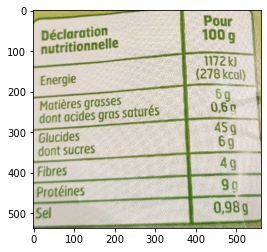

,0,1,2
0,Déclaration,,Pour
1,nutritionnelle,,100 g
2,Energie,,1172 kJ (278 kcal)
3,Matières grasses dont acides gras,saturés,"6 g 0,6g"
4,Glucides dont sucres,,45g 6g
5,Fibres,,49
6,Protéines,,9 g
7,Sel,,"0,98g"


25it [00:00, 12530.78it/s]


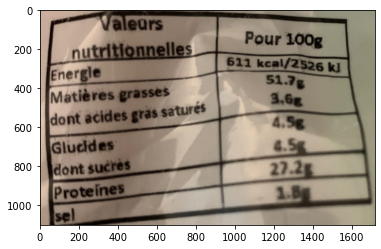

,0,1
0,Valears nutritionnelles,Pour 100g
1,,611 kcal/2526
2,Energle,kJ
3,Matières grasses dont acides gras saturés,51.7g 3.6g 4.5g
4,Glucdes,4.5g
5,dont sucrès,27.2
6,Proteines,1.8
7,,
8,sel,


34it [00:00, 11358.53it/s]


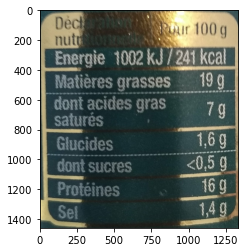

,0,1,2
0,Dec nut,ur,100 g
1,Energie,1002 kJ /241,kcal
2,Matières,grasses,19 g
3,dont saturés,acides gras,7g
4,Glucides,,"1,6 g"
5,,8,g 5
6,dont,sucres,"<0,5"
7,,Protéines,16 g
8,Sel,,"1,4 g"


37it [00:00, 14913.44it/s]


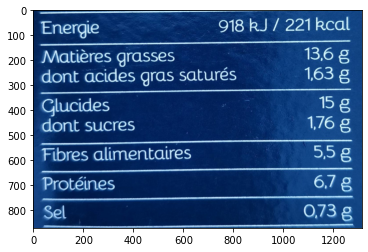

,0,1
0,918 kJ/ Energie,221 kcal
1,Matières grasses,"13,6 g"
2,,
3,dont acides gras saturés,"1,63 e"
4,Glucides,15
5,dont sucres,"1,76"
6,Fibres alimentaires,"5,5g"
7,Protéines,"6,7g"
8,Sel,"0,73 g"


An error has occured
An error has occured


66it [00:00, 18254.14it/s]


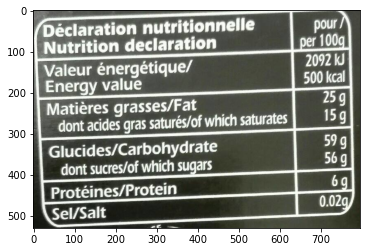

,0,1
0,Déclaration nutritionnelle Nutrition declaration,pour/ per 100g
1,Valeur énergétique/,2092 kJ
2,Energy value,500 kcal
3,Matières grasses/Fat dont acides gras saturés/of which,saturates 25 g 15 g
4,Glucides/Carbohydrate dont sucres/of which sugars,59 g 56g
5,Protéines/Protein,69
6,Sel/Salt,0.02g


68it [00:00, 68134.90it/s]


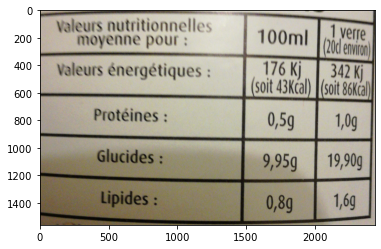

,0,1,2,3
0,Valeurs nutritionnelles moyenne pour:,,100ml,.1 verre 20d envion
1,Valeurs énergétiques:,,176 Kj (soit 43Kcal),342 Kj |(soit 86Kćal)
2,Protéines:,,"0,5g","1,0g"
3,Glucides:,,"9,95g","19,90g"
4,Lipides:,,"0,8g","1,6g"


67it [00:00, 22393.69it/s]


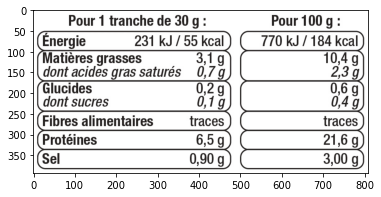

,0,1
0,Pour 1 tranche de 30 g,Pour 100 g
1,(Energie 231 kJ 55 kcal,770 kJ /184 kcal
2,"Matières grasses 3,1 g","10,4 g"
3,"dont acides gras saturés 0,7g","2,3 g"
4,"Glucides dont sucres 0,2 g 0,1 g","0,6 g 0,4 g"
5,Fibres alimentaires traces,traces
6,"Protéines 6,5g","21,6 g"
7,"(Sel 0,90 g","3,00 g"


38it [00:00, 19055.90it/s]


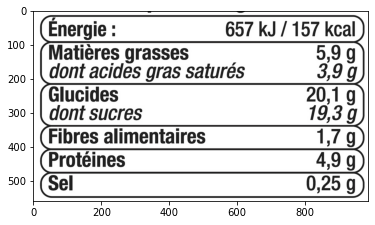

,0,1,2
0,Energie:,657 kJ 157,kcal
1,Matières grasses,,"5,9 g"
2,dont acides gras,saturés,"3,9 g"
3,Glucides,,"20,1 g"
4,dont sucres,,"19,3 g"
5,Fibres alimentaires,,"1,7 g"
6,Protéines,,"4,9 g"
7,(Sel,,"0,25 g"


64it [00:00, 16260.93it/s]


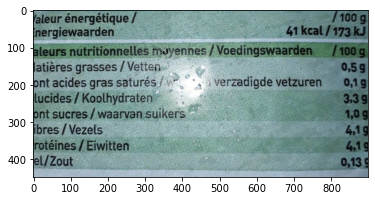

,0,1
0,Jaleur énergétique Energiewaarden,/ 100 g 41 kcal/173 kJ /
1,aleurs nutritionnelles,/100 g moyennes/Voedingswaarden
2,latières,"grasses/Vetten 0,5g"
3,,
4,ont acides gras,"saturés. 0,1g verzadigde vetzuren"
5,lucides /,Koolhydraten 3.3 9
6,ont sucres /,"waarvan suikers 1,0 g"
7,ibres/Vezels,"4,1 9"
8,rotéines / Eiwitten,"4,19"
9,el/Zout,"0,139"


156it [00:00, 18894.35it/s]


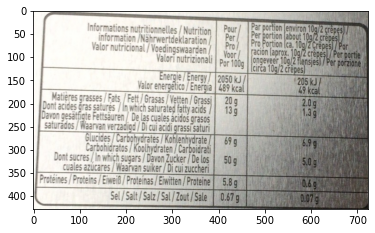

,0,1,2,3
0,Informations information Valor,nutritionnelles/Nutrition /Nährwertdeklaration/ nutricional/Voedingswaarden/ Valori nutrizionali |,"Par portion environ Pour/ Per portion about 10g/2 Per Pro Portion (ca, Pro/ ración (aprox. 10g/2 Voor Por 100g |ongeveer 10g/2 flensješ) (cirča 10g/2 crêpes)",10g/2 çrêpes) crêpes 10g/ZCrêpes) / Por crêpes / Per portie / Per porzione
1,,Energie/Energy/ Valor energêtico / Energia,2050 kJ/ 489 kcal 205 49,kJ/ kcal
2,Matieres grasses/Fats / Dont acides gras saturés /In Davon gesätfigte Fettsäuren / saturādos / Waarvan verzadigd,Fett/Grasas / Vetten /Grassi which saturated fatty acids/ De las cuales acidos grasos / Di cui acidi grassī saturi,2.0g 13g 20 g,1.3g
3,Glucides/Carbohydrates Dont sucres/ In which cuales azúcares/Waarvan,/ Kohlenhydrate / Carbohidratos/Koolhydraten/Carboidrati sugars/Davon Zucker/De los suiker/Di cui zuccheri,69 9 6.9 50 g,g 5.0g
4,,,g,0.6 g
5,Protéines/Proteins/Eiweiß/Proteinas/Eiwitten,/Proteine,5.8,
6,,Sel/Salt/Salz/Sal/Zout/Sale,0.67 g,0.07 g


An error has occured
An error has occured


50it [00:00, 18633.07it/s]


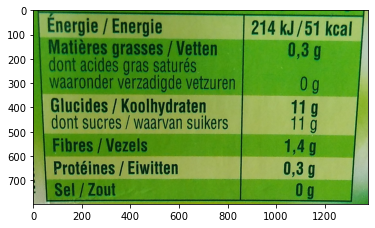

,0,1,2,3
0,Énergie/Energie,,214,kJ/51 kcal
1,Matières,grasses/Vetten,,"0,3 g"
2,dont acides,gras saturés,,
3,,,,
4,waaronder,verzadigde vetzuren,,0 g
5,Glucides /,Koolhydraten suikers,,11 g 11g
6,dont,sucres/waarvan,,
7,Fibres/Vezels,,,"1,4g"
8,Protéines,/ Eiwitten,,"0,3 g"
9,Sel / Zout,,,0 g


31it [00:00, 15547.46it/s]


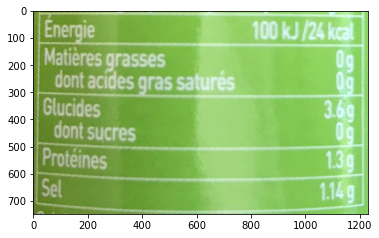

,0,1
0,Energie,100KJ/24 kcal
1,Matières grasses dont acides gras saturés,0g 0g
2,Glucides dont sucres,3.6g 0g
3,Protéines,1.3g
4,Sel,1.14g


36it [00:00, 13831.18it/s]


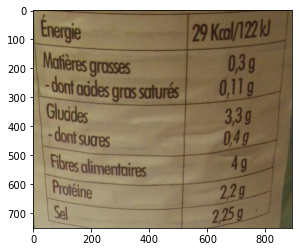

,0,1,2
0,Елeгge,,29 Kal/122 k)
1,Matières grasses,,"0,3 g"
2,,,"0,11g"
3,- donf acides,gras saturés,
4,Gludes,,"3,3g"
5,-dont sucres,,"0,4g"
6,Fibres,alimentaires,4g
7,Protéine,,"2,2g"
8,Sel,,"2,25 g"


47it [00:00, 23213.88it/s]


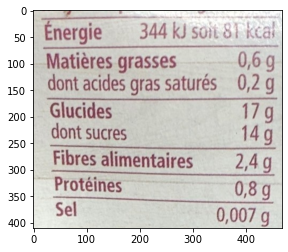

,0,1
0,Énergie 344 kJ soit 81,kcal
1,Matières grasses,"0,6 g"
2,dont acides gras saturés,"0,2 g"
3,Glucides,17 g
4,dont sucres,14 g
5,Fibres alimentaires,"2,4 g"
6,Protéines,"0,8 g"
7,"0,007 Sel",g


109it [00:00, 51030.15it/s]


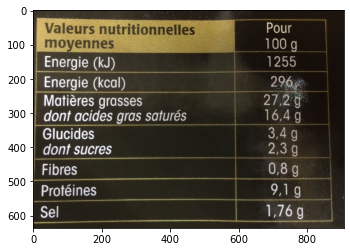

,0,1,2
0,Valeurs nutritionnelles moyennes,,Pour 100 g
1,Energie (kJ),,1255
2,Energie (kcal),,296
3,Matières grasses dont acides gras,saturés,"27.2 g 16,4 g"
4,Glucides dont sucres,,"3,4 g 2,3 g"
5,Fibres,,"0,8 g"
6,Protéines,,"9,1 g"
7,Sel,,"1,76 g"


26it [00:00, 14157.07it/s]


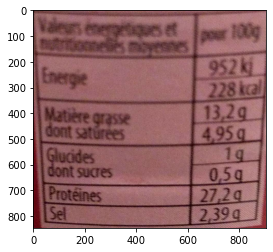

,0,1,2
0,Valeurs utritionnelies,énergetiques et miomes,pour 100g
1,,,952 kj
2,Energie,,228kcal
3,Matière,grasse,"13,2g"
4,dont,satúrées,"4,95g"
5,Glucides dont,sucres,"1g 0,5g"
6,Proteines,,"27,2g"
7,Sel,,"2,39g"


33it [00:00, 16570.34it/s]


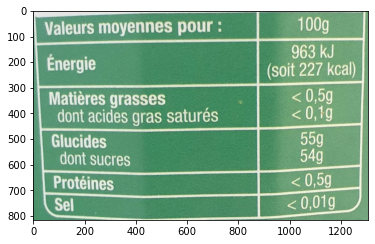

,0,1,2
0,Valeurs,moyennes pour:,100g
1,Énergie,,963 kJ
2,,,(soit 227 kcal)
3,Matières,grasses,"< 0,5g"
4,dont acides,gras saturés,"< 0,1g"
5,Glucides,,55g
6,dont sucres,,54g
7,Protéines,,"< 0,5g"
8,Sel,,"< 0,01g"


An error has occured
An error has occured


66it [00:00, 19038.79it/s]


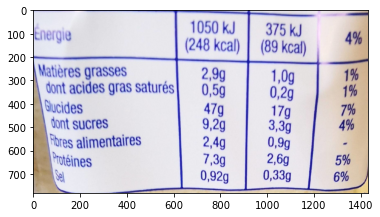

,0,1,2,3,4
0,Énergie,,1050 kJ,375 kJ,4%
1,,,(248 kcal) |,(89 kcal),
2,Matières,grasses,"2,9g","1,0g",1%
3,,,,,1%
4,dont acides,gras saturés,"0,5g","0,2g",
5,Glucides dont sucres Fbres,alimentaires,"47g 9,2g 2,4g","17g 3,3g 0,9g",7% 4% 5%
6,Protéines Sel,,"7,3g 0,92g","2,6g 0,33g",6%


In [7]:
for product_barcode in df.barcode.values:
    try: 
        image_path = df[df.barcode==product_barcode].source_image.iloc[0]
        #Get table bbx
        crop = convert_to_dict(df[df.barcode==product_barcode]['data'].iloc[0])['annotation']['crop']
        table_bbx = Rectangle(crop['start']['x'],crop['start']['y'],crop['end']['x'],crop['end']['y'])
        #image_url
        url = 'https://static.openfoodfacts.org/images/products'+image_path
        off_image, table = predict(url,table_bbx,col_config,line_config)
        plt.imshow(off_image.cropped_image)
        plt.show()
        display(pd.DataFrame(table))
        
    except:
        print("An error has occured")